## Display FCN Activations 
 - First we generate the heatmaps, and also visually cehck them. 
- the we pass the heatmaps to the routine that prodcues the scores 

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys,os, pprint, pickle, json
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
if '../..' not in sys.path:
    print("appending '..' to sys.path")
    sys.path.append('../..')
print(sys.path)    
import numpy as np
# import matplotlib as plt
import mrcnn.utils         as utils
import mrcnn.visualize     as visualize
import mrcnn.visualize_2   as vis2
import mrcnn.prep_notebook as prep
from mrcnn.prep_notebook import build_fcn_inference_pipeline, build_mrcnn_inference_pipeline,run_mrcnn_detection,run_mrcnn_inference_pipeline
from mrcnn.prep_notebook import build_fcn_inference_pipeline_newshapes, build_mrcnn_inference_pipeline_newshapes
from mrcnn.prep_notebook import get_inference_batch, get_image_batch, run_mrcnn_detection, run_fcn_detection
from mrcnn.visualize     import display_training_batch
from mrcnn.coco          import prep_coco_dataset
from mrcnn.newshapes     import prep_newshape_dataset
import matplotlib.pyplot as plt

Current working dir:  /home/kbardool/git_projs/mrcnn3/notebooks/DEMO - Newshapes-BCE - new_heatmap_layer
appending '..' to sys.path
['', '/home/kbardool/anaconda3/envs/TFG/lib/python35.zip', '/home/kbardool/anaconda3/envs/TFG/lib/python3.5', '/home/kbardool/anaconda3/envs/TFG/lib/python3.5/plat-linux', '/home/kbardool/anaconda3/envs/TFG/lib/python3.5/lib-dynload', '/home/kbardool/anaconda3/envs/TFG/lib/python3.5/site-packages', '/home/kbardool/anaconda3/envs/TFG/lib/python3.5/site-packages/IPython/extensions', '/home/kbardool/.ipython', '../..']


Using TensorFlow backend.


### Setup Coco model

In [ ]:
# WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_2298.h5' 
WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_0900.h5'
##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
parser = utils.command_line_parser()
input_parms  =" --batch_size     1  "
input_parms +=" --mrcnn_logs_dir train_mrcnn_coco "
input_parms +=" --fcn_logs_dir   train_fcn8_bce " 
input_parms +=" --mrcnn_model    last "
input_parms +=" --fcn_model      " + WEIGHT_FILE + "  "
# input_parms +=" --fcn_model      last "
input_parms +=" --fcn_layer      all"
input_parms +=" --fcn_arch       fcn8 " 
input_parms +=" --sysout         screen "
input_parms +=" --scale_factor   4"
# input_parms +=" --coco_classes   78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 "
input_parms +=" --coco_classes       78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 10 11 13 14 15 "

args = parser.parse_args(input_parms.split())
utils.display_input_parms(args)
# import matplotlib as plt
%matplotlib inline

mrcnn_model, fcn_model = build_fcn_inference_pipeline(args = args)

### Setup Newshapes model

In [2]:
##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
parser = utils.command_line_parser()
input_parms  =" --batch_size     1  "
input_parms +=" --mrcnn_logs_dir train_mrcnn_newshapes "
input_parms +=" --fcn_logs_dir   train_fcn8L2_BCE "
input_parms +=" --mrcnn_model    last "
input_parms +=" --fcn_model      last "
input_parms +=" --fcn_model      last "
input_parms +=" --fcn_layer      all"
input_parms +=" --fcn_arch       fcn8L2 " 
input_parms +=" --sysout         screen "
input_parms +=" --scale_factor   1"
args = parser.parse_args(input_parms.split())

# DEVICE = "/cpu:1"  # /cpu:0 or /gpu:0
# with tf.device(DEVICE):

mrcnn_model, fcn_model = prep.build_fcn_inference_pipeline_newshapes(args = args,verbose = 1)

MODE IS: inference

--> Execution started at: 02-10-2019 @ 16:03:24
    Tensorflow Version: 1.8.0   Keras Version : 2.1.6 
    Build_mrcnn_inference_pipeline_newshapes MODE is : inference

   Arguments passed :
   --------------------
   batch_size                     1
   coco_classes                   None
   epochs                         1
   evaluate_method                1
   fcn_arch                       FCN8L2
   fcn_bce_loss_class             0
   fcn_bce_loss_method            1
   fcn_layers                     ['all']
   fcn_logs_dir                   train_fcn8L2_BCE
   fcn_losses                     fcn_BCE_loss
   fcn_model                      last
   last_epoch                     0
   lr                             0.001
   mrcnn_exclude_layers           None
   mrcnn_layers                   ['mrcnn', 'fpn', 'rpn']
   mrcnn_logs_dir                 train_mrcnn_newshapes
   mrcnn_model                    last
   new_log_folder                 False
   opt            

    roi_align_classifier           :  shape: (1, ?, 7, 7, 256)     KB.shape:(None, 1000, 7, 7, 256)  Keras Tensor: True
    mrcnn_class_conv1              :  shape: (?, 1000, 1, 1, 1024)  KB.shape:(None, 1000, 1, 1, 1024)  Keras Tensor: True
    mrcnn_class_bn1                :  shape: (?, 1000, 1, 1, 1024)  KB.shape:(None, 1000, 1, 1, 1024)  Keras Tensor: True
    mrcnn_class_relu1              :  shape: (?, 1000, 1, 1, 1024)  KB.shape:(None, 1000, 1, 1, 1024)  Keras Tensor: True
                                   
    mrcnn_class_conv2              :  shape: (?, 1000, 1, 1, 1024)  KB.shape:(None, 1000, 1, 1, 1024)  Keras Tensor: True
    mrcnn_class_bn2                :  shape: (?, 1000, 1, 1, 1024)  KB.shape:(None, 1000, 1, 1, 1024)  Keras Tensor: True
    mrcnn_class_relu2              :  shape: (?, 1000, 1, 1, 1024)  KB.shape:(None, 1000, 1, 1, 1024)  Keras Tensor: True
                                   
    pool_squeeze(Shared)           :  shape: (?, 1000, 1024)       KB.shape:

    Weights file loaded: /home/kbardool/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000/mrcnn_0472.h5 
MRCNN  MODEL Load weight file COMPLETE 
>>> Initialize Paths
 Linx  Linux

   Arguments passed :
   --------------------
   batch_size                     1
   coco_classes                   None
   epochs                         1
   evaluate_method                1
   fcn_arch                       FCN8L2
   fcn_bce_loss_class             0
   fcn_bce_loss_method            1
   fcn_layers                     ['all']
   fcn_logs_dir                   train_fcn8L2_BCE
   fcn_losses                     fcn_BCE_loss
   fcn_model                      last
   last_epoch                     0
   lr                             0.001
   mrcnn_exclude_layers           None
   mrcnn_layers                   ['mrcnn', 'fpn', 'rpn']
   mrcnn_logs_dir                 train_mrcnn_newshapes
   mrcnn_model                    last
   new_log_folder                 False
   opt             

    hm_indices                     :  shape: (?, 2)                KB.shape:(None, 2)             Keras Tensor: False
    pt2_heatmaps                   :  shape: (?, 7, 128, 128)      KB.shape:(None, 7, 128, 128)   Keras Tensor: False
    pt2_heatmaps                   :  shape: (?, 128, 128)         KB.shape:(None, 128, 128)      Keras Tensor: False
    old_style_scores               :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False
    alt_scores_1                   :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False
    alt_scores_1_scattered         :  shape: (1, 7, 64, 3)         KB.shape:(1, 7, 64, 3)         Keras Tensor: False
    alt_scores_1_norm(by_class)    :  shape: (1, 7, 64, 3)         KB.shape:(1, 7, 64, 3)         Keras Tensor: False
    alt_scores_1_norm(by_image)    :  shape: (?, 3)                KB.shape:(None, 3)             Keras Tensor: False
    Normalize heatmap within each class !---------------

    Weights file loaded: /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0181.h5 
FCN  MODEL Load weight file COMPLETE 


## Set and load weight files

#### MRCNN weight files

In [3]:
# MRCNN_DIR_WEIGHTS =  'F:/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000'
MRCNN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000'

# files = ['fcn_0001.h5','fcn_0027.h5','fcn_0036.h5','fcn_0051.h5','fcn_0076.h5','fcn_0106.h5','fcn_0156.h5']
# files   = ['fcn_0104.h5','fcn_0150.h5','fcn_0205.h5','fcn_0249.h5','fcn_0293.h5','fcn_0346.h5','fcn_0419.h5']
mrcnn_files   = ['mrcnn_0001.h5', 'mrcnn_0058.h5', 'mrcnn_0152.h5', 'mrcnn_0247.h5', 'mrcnn_0389.h5','mrcnn_0472.h5']

FILE_IDX = -1
mrcnn_weights_file = os.path.join(MRCNN_DIR_WEIGHTS  , mrcnn_files[FILE_IDX])
print("Loading weights ", mrcnn_weights_file)
mrcnn_model.load_model_weights(mrcnn_weights_file)

Loading weights  /home/kbardool/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000/mrcnn_0472.h5
-----------------------------------------------
 Load Model with init parm: [ /home/kbardool/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000/mrcnn_0472.h5 ]
-----------------------------------------------
 ---> Explicit weight file
>>> load_weights() from : /home/kbardool/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000/mrcnn_0472.h5
    Weights file loaded: /home/kbardool/models_newshapes/train_mrcnn_newshapes/mrcnn20181216T0000/mrcnn_0472.h5 
MRCNN  MODEL Load weight file COMPLETE 


#### FCN weight files

In [5]:
## BCE with original heatmap layer                 
# FCN_DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8L2_BCE/fcn20181224T0000'  
# FCN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20181224T0000' 
# fcn_files   = ['fcn_0001.h5', 'fcn_0150.h5', 'fcn_0346.h5', 'fcn_0421.h5',
#                'fcn_0450.h5', 'fcn_0521.h5', 'fcn_0687.h5', 'fcn_0793.h5',
#                'fcn_0821.h5', 'fcn_0940.h5', 'fcn_1012.h5', 'fcn_1127.h5',
#                'fcn_1644.h5', 'fcn_1776.h5', 'fcn_1848.h5', 'fcn_2017.h5','fcn_2084.h5']

## BCE with new heatmap layer                 
# FCN_DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8L2_BCE/fcn20180208T0000'  
FCN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000' 
fcn_files   = ['initialization', 
           'fcn_0001.h5', 'fcn_0003.h5', 'fcn_0005.h5', 'fcn_0009.h5',
           'fcn_0012.h5', 'fcn_0020.h5', 'fcn_0023.h5', 'fcn_0027.h5',
           'fcn_0033.h5', 'fcn_0047.h5', 'fcn_0070.h5', 'fcn_0080.h5',
           'fcn_0101.h5', 'fcn_0106.h5', 'fcn_0112.h5', 'fcn_0124.h5',
           'fcn_0138.h5', 'fcn_0144.h5', 'fcn_0161.h5', 'fcn_0171.h5', 'fcn_0181.h5']

# FCN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes/train_fcn8L2_BCE2/fcn20190131T0000' 
# fcn_files   = ['fcn_0001.h5', 'fcn_0022.h5', 'fcn_0057.h5', 'fcn_0092.h5',
#                'fcn_0101.h5', 'fcn_0220.h5', 'fcn_0290.h5', 'fcn_0304.h5',
#                'fcn_0372.h5', 'fcn_0423.h5', 'fcn_0500.h5', 'fcn_0530.h5',
#                'fcn_0578.h5', 'fcn_0648.h5']

# FCN_DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8L2_BCE2/fcn20190131T0000'  
# fcn_files   = ['fcn_0500.h5']


FILE_IDX = 5
fcn_weights_file = os.path.join(FCN_DIR_WEIGHTS  , fcn_files[FILE_IDX])
print("Loading weights ", fcn_weights_file)
fcn_model.load_model_weights(fcn_weights_file)

Loading weights  /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0012.h5
-----------------------------------------------
 Load Model with init parm: [ /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0012.h5 ]
-----------------------------------------------
 ---> Explicit weight file
>>> load_weights() from : /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0012.h5
    Weights file loaded: /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0012.h5 
FCN  MODEL Load weight file COMPLETE 


##  Datasets

### Prep Newshapes Dataset

In [70]:
# del dataset_train, dataset_val, train_generator, val_generator
# dataset_test , test_generator   = prep_newshape_dataset( mrcnn_model.config,  1000, generator=True)
# with open('newshapes_dataset_1000_B.pkl', 'wb') as outfile:
#     pickle.dump(dataset_test, outfile)
## -- OR --

# with open("E:\\git_projs\\MRCNN3\\train_newshapes\\newshapes_dataset.pkl", 'rb') as infile:
# with open("E:\\git_projs\\MRCNN3\\train_newshapes\\newshapes_test_dataset_1000_B.pkl", 'rb') as infile:
with open("/home/kbardool/mrcnn3/train_newshapes/newshapes_test_dataset_1000_B.pkl", 'rb') as infile:
    dataset_test = pickle.load(infile)

In [7]:
dataset_test.display_active_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))
class_names = dataset_test.class_names

[1, 2, 3, 4, 5, 6]
internal_class:  1 ext_cls: 1 name: None - person
internal_class:  2 ext_cls: 2 name: None - car
internal_class:  3 ext_cls: 3 name: None - sun
internal_class:  4 ext_cls: 4 name: None - building
internal_class:  5 ext_cls: 5 name: None - tree
internal_class:  6 ext_cls: 6 name: None - cloud
Testing Dataset Image Count: 1000
Testing Dataset Class Count: 7


###  Display some images from dataset

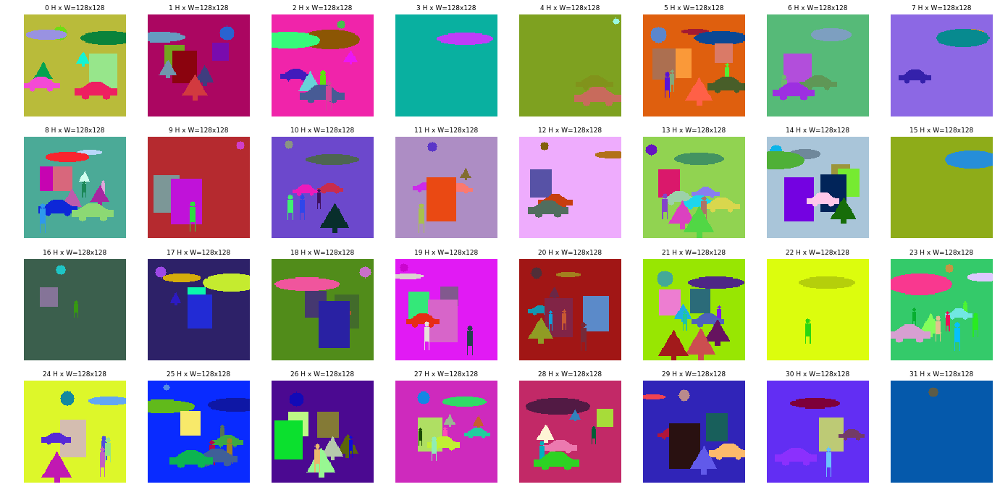

In [71]:
image_list = list(range(0,32))
image_titles = [str(i) for i in image_list]
images = get_image_batch(dataset_test, image_list)
visualize.display_images(images, titles = image_titles, cols = 8, width = 24)

####  Display next image from generator

image id :  91
 Image_id    :  91  Reference:  [('cloud', (209, 232, 173), (53, 31, 37, 7)), ('person', (10, 102, 243), (83, 65, 2, 10)), ('tree', (194, 68, 131), (46, 69, 14, 14)), ('person', (126, 129, 23), (84, 82, 2, 14)), ('person', (231, 133, 22), (62, 88, 3, 15)), ('car', (247, 125, 84), (62, 107, 30, 15))] Coco Id: 91
 Image meta  :  [ 91 128 128   3   0   0 128 128]
 Class ids   :  (6,)    [6 1 5 1 1 2]
 Class Names :  ['cloud', 'person', 'tree', 'person', 'person', 'car']


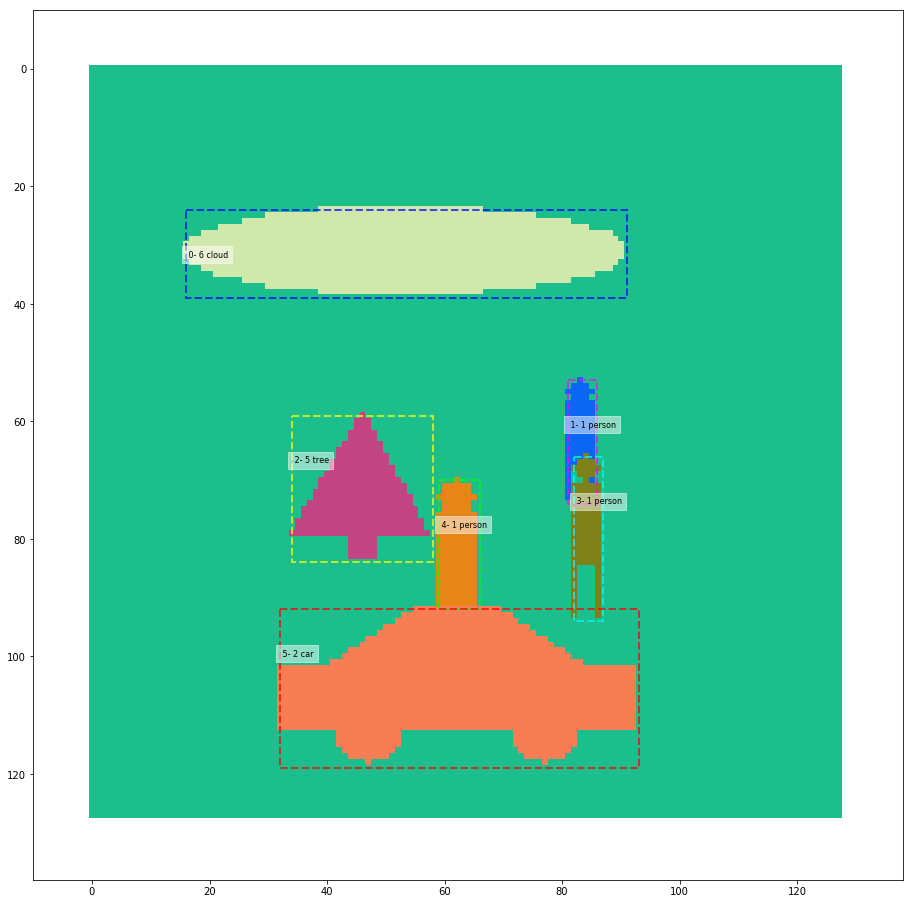

6

In [13]:
# batch_x, batch_y = next(test_generator)
visualize.display_training_batch(dataset_test,  batch_x)
len(batch_x)

#### Load a specific image using image_id

## Pass image through MRCNN and FCN

### Display an image 

Processing 1 images
image                    shape: (128, 128, 3)         min:    3.00000  max:  255.00000
molded_images            shape: (1, 128, 128, 3)      min: -104.70000  max:  131.30000
image_metas              shape: (1, 15)               min:    0.00000  max:  128.00000
image id :  27
 Image_id    :  27  Reference:  [('sun', (19, 135, 229), (35, 21, 8, 8)), ('cloud', (48, 219, 102), (86, 26, 27, 6)), ('tree', (154, 183, 146), (68, 48, 9, 9)), ('tree', (198, 93, 47), (104, 50, 9, 9)), ('car', (32, 207, 158), (102, 67, 16, 8)), ('building', (175, 223, 99), (43, 67, 15, 21)), ('person', (255, 74, 185), (62, 71, 2, 11)), ('person', (27, 75, 3), (31, 72, 2, 11)), ('car', (193, 240, 51), (60, 80, 20, 10)), ('person', (143, 237, 181), (48, 88, 3, 15))] Coco Id: 27
 Image meta  :  [        27        128        128          3          0          0        128        128]
 Class ids   :  (10,)    [         3          6          5          5          2          4          1          1   

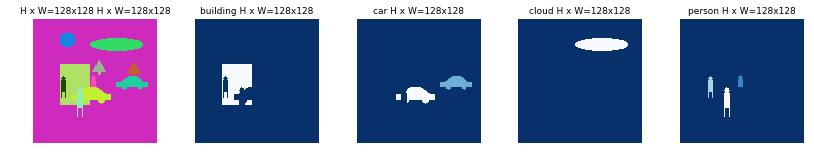

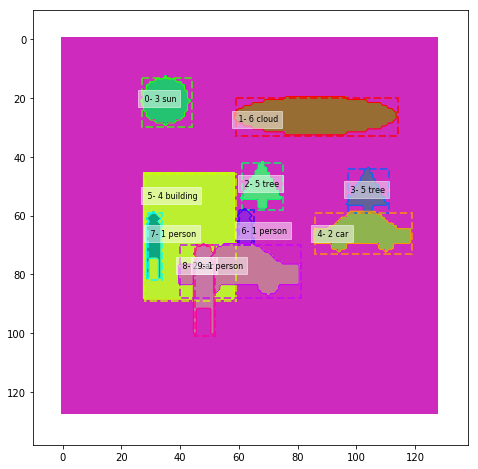

In [72]:
IMAGE_ID = 27

batch_x = prep.get_inference_batch(dataset_test, mrcnn_model.config, image_ids = [IMAGE_ID], display= True)

###  Manipulate an image, add an out of context object 

In [ ]:
## dataset_test.image_info[3]['shapes'].pop()

In [73]:
pp.pprint(dataset_test.image_info[IMAGE_ID]['shapes'])

[ ('sun', (19, 135, 229), (35, 21, 8, 8)),
  ('cloud', (48, 219, 102), (86, 26, 27, 6)),
  ('tree', (154, 183, 146), (68, 48, 9, 9)),
  ('tree', (198, 93, 47), (104, 50, 9, 9)),
  ('car', (32, 207, 158), (102, 67, 16, 8)),
  ('building', (175, 223, 99), (43, 67, 15, 21)),
  ('person', (255, 74, 185), (62, 71, 2, 11)),
  ('person', (27, 75, 3), (31, 72, 2, 11)),
  ('car', (193, 240, 51), (60, 80, 20, 10)),
  ('person', (143, 237, 181), (48, 88, 3, 15))]


In [62]:
# dataset_test.image_info[IMAGE_ID]['shapes'].pop()

('sun', (22, 31, 4), (93, 107, 5, 5))

In [74]:
## object is (shape, color, dims)
# color = tuple([random.randint(0, 255) for _ in range(3)])
yellow = (228, 236, 53)
black = (22, 31, 4)
# dims  = (10,110,20,8)
# -- add sun in bottom right 
# obj = ('sun', yellow , (100, 120, 12, 12))
# obj = ('sun', black, (100, 120, 12, 12))
# obj = ('sun', (102, 21, 191), (120, 110, 7, 7)) ### <----  Add sun to image_id 13
obj = ('sun', black, ( 93,  107, 8, 8))         ##   <--- 'image27' Sun positioned in flipped location
# obj = ('sun', black, ( 64,  20, 5, 5))         ##   <--- 'image3A' Sun positioned in top
# obj = ('sun', black, ( 64,  64, 5, 5))         ##   <--- 'image3A' Sun positioned in middle
# obj = ('sun', black, ( 64,  90, 5, 5))        ##   <--- 'image3A' Sun positioned in mid bottom
# obj = ('sun', black, ( 64, 110, 5, 5))        ##   <--- 'image3A' Sun positioned in far bottom

# -- add person to top area
# obj =('person', (224, 188, 174), (23, 18, 2, 10))   ## <--- oddly shaped car

# -- add car to top area
# obj =('car', (224, 188, 174), (23, 18, 2, 10))   ## <--- oddly shaped car
# obj =('car', (224, 188, 174), (23, 18, 15, 10))   ## <--- normal shaped car
# obj = ('car', (64, 67, 30), (25,5,15,10))
# -- add car to bottom right area
# obj = ('car', color , (103,120,15,10))
# -- add building
# obj =("building",color, (25,110,10,15))
# -- add an object at a random position
# color, dims =dataset_test.random_shape("sun", 128,128) 

# --append the object to the image

# dataset_test.image_info[image_id]['shapes'].append((shape, color, dims))
dataset_test.image_info[IMAGE_ID]['shapes'].append(obj)

In [77]:
# pp.pprint(dataset_test.image_info[IMAGE_ID])
pp.pprint(dataset_test.image_info[IMAGE_ID]['shapes'][6])
# dataset_test.image_info[IMAGE_ID]['shapes'][6] =  ('person', (255, 74, 185), (62, 71, 2, 11))
pp.pprint(dataset_test.image_info[IMAGE_ID])
### Get image for inference run

('person', (82, 240, 51), (105, 15, 2, 12))
{ 'bg_color': array([       206,         42,        189], dtype=int32),
  'height': 128,
  'id': 27,
  'path': None,
  'shapes': [ ('sun', (19, 135, 229), (35, 21, 8, 8)),
              ('cloud', (48, 219, 102), (86, 26, 27, 6)),
              ('tree', (154, 183, 146), (68, 48, 9, 9)),
              ('tree', (198, 93, 47), (104, 50, 9, 9)),
              ('car', (32, 207, 158), (102, 67, 16, 8)),
              ('building', (175, 223, 99), (43, 67, 15, 21)),
              ('person', (255, 74, 185), (62, 71, 2, 11)),
              ('person', (27, 75, 3), (31, 72, 2, 11)),
              ('car', (193, 240, 51), (60, 80, 20, 10)),
              ('person', (143, 237, 181), (48, 88, 3, 15)),
              ('sun', (22, 31, 4), (93, 107, 8, 8))],
  'source': 'shapes',
  'width': 128}


Processing 1 images
image                    shape: (128, 128, 3)         min:    3.00000  max:  255.00000
molded_images            shape: (1, 128, 128, 3)      min: -104.70000  max:  131.30000
image_metas              shape: (1, 15)               min:    0.00000  max:  128.00000
image id :  27
 Image_id    :  27  Reference:  [('sun', (19, 135, 229), (35, 21, 8, 8)), ('cloud', (48, 219, 102), (86, 26, 27, 6)), ('tree', (154, 183, 146), (68, 48, 9, 9)), ('tree', (198, 93, 47), (104, 50, 9, 9)), ('car', (32, 207, 158), (102, 67, 16, 8)), ('building', (175, 223, 99), (43, 67, 15, 21)), ('person', (255, 74, 185), (62, 71, 2, 11)), ('person', (27, 75, 3), (31, 72, 2, 11)), ('car', (193, 240, 51), (60, 80, 20, 10)), ('person', (143, 237, 181), (48, 88, 3, 15)), ('sun', (22, 31, 4), (93, 107, 8, 8))] Coco Id: 27
 Image meta  :  [        27        128        128          3          0          0        128        128]
 Class ids   :  (11,)    [         3          6          5          5        

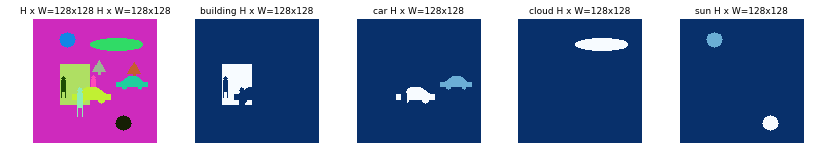

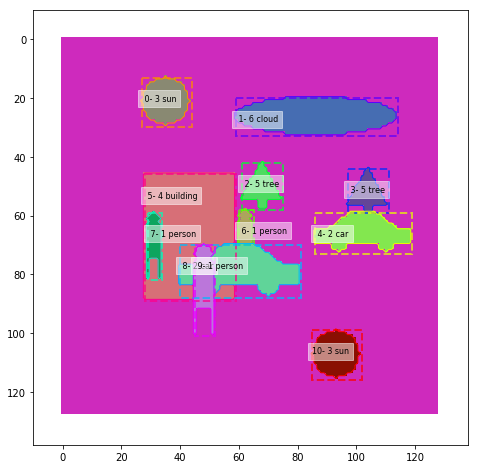

In [78]:
batch_x = prep.get_inference_batch(dataset_test, mrcnn_model.config, image_ids = [IMAGE_ID], display= True)

###  Predict using `run_mrcnn_inference_pipeline()` model prediction

In [19]:
output = prep.run_mrcnn_inference_pipeline(mrcnn_model, dataset_test,  input= batch_x, verbose = 1)

for i in output['mrcnn_output']:
    print(i.shape)

** Pass through MRCNN model:
/* Inputs */
Input  0:  (input_image:0                           ) 	  Input shape: (1, 128, 128, 3)
Input  1:  (input_image_meta:0                      ) 	  Input shape: (1, 15)

Requested layers:
-----------------
Layer   0:  (mrcnn_detection/detections:0            ) 	  Output shape: <unknown>
Layer   1:  (ROI/rpn_roi_proposals:0                 ) 	  Output shape: (1, ?, ?)
Layer   2:  (mrcnn_class_lambda/mrcnn_class:0        ) 	  Output shape: (?, 1000, 7)
Layer   3:  (mrcnn_bbox_lambda/mrcnn_bbox:0          ) 	  Output shape: (?, 1000, 7, 4)
Layer   4:  (cntxt_layer/pred_heatmap:0              ) 	  Output shape: (1, 128, 128, 7)
Layer   5:  (cntxt_layer/pred_heatmap_scores:0       ) 	  Output shape: (1, 7, 64, 24)

/* Outputs */
Output idx:  0    Layer:  0: (mrcnn_detection/detections:0            ) 	  Output shape: (1, 64, 7)
Output idx:  1    Layer:  1: (ROI/rpn_roi_proposals:0                 ) 	  Output shape: (1, 1000, 4)
Output idx:  2    Layer:  

##### Load model input and outputs

In [10]:
# mrcnn_model.layer_info()
# from mrcnn.prep_notebook import run_pipeline, run_pipeline_on_input
# mrcnn_output, fcn_output, fcn_input = run_pipeline_on_input(mrcnn_model, fcn_model, mrcnn_input, verbose = 0)
model_detections                = output['mrcnn_output'][0]          # layer:  0   shape: (1, 64, 7)
model_rpn_roi_proposals         = output['mrcnn_output'][1]          # layer:  1   shape: (1, 1000, 4)
model_mrcnn_class               = output['mrcnn_output'][2]          # layer:  2   shape: (1, 1000, 7)
model_mrcnn_bbox                = output['mrcnn_output'][3]          # layer:  3   shape: (1, 1000, 7, 4)
model_pr_heatmap              = output['mrcnn_output'][4]          # layer:  4   shape: (1, 128, 128, 7)
model_pr_heatmap_scores       = output['mrcnn_output'][5]          # layer:  5   shape: (1, 7, 64, 24)
# model_pr_heatmap                = mrcnn_output['mrcnn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
# model_pr_heatmap_scores         = mrcnn_output['mrcnn_output'][1]          # layer:  1   shape: (1, 81, 200, 11)
# model_gt_heatmap                = mrcnn_output['mrcnn_output'][2]          # layer:  2   shape: (1, 256, 256, 81)
# model_gt_heatmap_scores         = mrcnn_output['mrcnn_output'][3]          # layer:  3   shape: (1, 81, 200, 11)
# model_fcn_heatmap               = mrcnn_output['fcn_output'][0]          # layer:  0   shape: (1, 256, 256, 81)
# model_fcn_softmax               = mrcnn_output['fcn_output'][1]          # layer:  1   shape: ()
# model_MSE_loss                  = mrcnn_output['fcn_output'][2]          # layer:  1   shape: ()
# model_CE_loss                   = mrcnn_output['fcn_output'][3]          # layer:  1   shape: ()
# # print('model_pr_heatmap       : ',model_gt_heatmap.shape)
# print('model_pr_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_gt_heatmap       : ',model_gt_heatmap.shape)
# print('model_gt_heatmap_scores: ',model_gt_heatmap_scores.shape)
# print('model_fcn_heatmap      :', model_fcn_heatmap.shape)
# print('model_fcn_softmax      :', model_fcn_softmax.shape)
# print(model_CE_loss,model_MSE_loss)
print(model_pr_heatmap_scores.shape)
img_id = 0
print('Image id: ',img_id, ' Coco ID: ', dataset_test.image_info[img_id]['id'])
# gt_class_ids = np.unique(model_gt_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
pr_class_ids = np.unique(model_pr_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
# print('Image : {}  Ground Truth ClassIds: {}'.format(img_id, gt_class_ids))
print('Image : {}  Predicted    ClassIds: {}'.format(img_id, pr_class_ids))

(1, 7, 64, 24)
Image id:  0  Coco ID:  0
Image : 0  Predicted    ClassIds: [0, 1, 6]


###  Predict using `run_mrcnn_detection()` model prediction

In [79]:
results = run_mrcnn_detection(mrcnn_model, dataset_test, image_ids = [IMAGE_ID], verbose = 0, display = False)
r = results[0]

results[0].keys()
for i, r in enumerate(results):
    print('\n output ', i, '  ',sorted(r.keys()))
    for key in sorted(r):
        print(key.ljust(20), r[key].shape)    



 output  0    ['class_ids', 'detection_ind', 'detections', 'gt_bboxes', 'gt_class_ids', 'image', 'image_meta', 'molded_image', 'molded_rois', 'orig_image_meta', 'pr_hm', 'pr_hm_scores', 'pr_scores', 'pr_scores_by_class', 'rois', 'scores']
class_ids            (12,)
detection_ind        (12,)
detections           (64, 7)
gt_bboxes            (11, 4)
gt_class_ids         (11,)
image                (128, 128, 3)
image_meta           (15,)
molded_image         (128, 128, 3)
molded_rois          (12, 4)
orig_image_meta      (15,)
pr_hm                (128, 128, 7)
pr_hm_scores         (7, 64, 24)
pr_scores            (12, 24)
pr_scores_by_class   (7, 64, 24)
rois                 (12, 4)
scores               (12,)



PR_SCORES:
------------------------------------------------------------------------------------------------------------------------------------------------------
                                            |         alt score 0         |            alt score 1              |            alt score 2              |
        class            TP mrcnn   normlzd |  gaussian   bbox   nrm.scr* |  ga.sum    mask     score   norm    |  ga.sum    mask     score   norm    |
seq  id name             FP score    score  |    sum      area   gau.sum  |  in mask   sum              score   |  in mask   sum              score   |
------------------------------------------------------------------------------------------------------------------------------------------------------
 60   1 person           1  0.9997   1.0000 |  0.9324   217.0000  0.9324  |  21.3630   32.0000  0.6676  1.0000  |  21.3630   32.0000  0.6676  1.0000  |   47.50   87.50
 58   1 person           1  0.9992   0.9996 |  0.8726   100.00

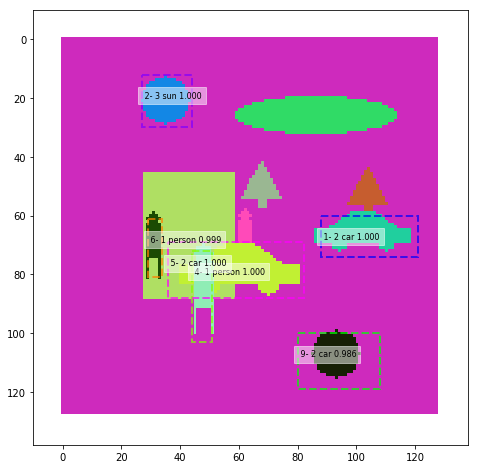

In [81]:
#### Display scores

# vis2.display_mrcnn_scores(r, class_names, display = False)
# print()
vis2.display_pr_scores(r['pr_scores'], class_names, display = True)
visualize.display_instances(r['image'], r['rois'], r['class_ids'], class_names, r['scores'], only_classes= [1,2,3], size =8)

In [82]:
fcn_results = run_fcn_detection( fcn_model,mrcnn_model, dataset_test, image_ids = [IMAGE_ID], verbose = 0)
f = fcn_results[0]

fcn_results[0].keys()
for i, j in enumerate(fcn_results):
    print('\n output ', i, '  ',sorted(j.keys()))
    for key in sorted(j):
        print(key.ljust(20), j[key].shape)    


 output  0    ['class_ids', 'detection_ind', 'detections', 'fcn_hm', 'fcn_hm_scores', 'fcn_scores', 'fcn_scores_by_class', 'fcn_sm', 'gt_bboxes', 'gt_class_ids', 'image', 'image_meta', 'molded_image', 'molded_rois', 'orig_image_meta', 'pr_hm', 'pr_hm_scores', 'pr_scores', 'pr_scores_by_class', 'rois', 'scores']
class_ids            (12,)
detection_ind        (12,)
detections           (64, 7)
fcn_hm               (128, 128, 7)
fcn_hm_scores        (7, 64, 24)
fcn_scores           (12, 24)
fcn_scores_by_class  (7, 64, 24)
fcn_sm               (128, 128, 7)
gt_bboxes            (11, 4)
gt_class_ids         (11,)
image                (128, 128, 3)
image_meta           (15,)
molded_image         (128, 128, 3)
molded_rois          (12, 4)
orig_image_meta      (15,)
pr_hm                (128, 128, 7)
pr_hm_scores         (7, 64, 24)
pr_scores            (12, 24)
pr_scores_by_class   (7, 64, 24)
rois                 (12, 4)
scores               (12,)


In [83]:
####
## OR
########
# original_img = get_image_batch(dataset_test, image_id, display =  True)
# results = mrcnn_model.detect(original_img, verbose=1)
# r = results[0]sualize.display_mrcnn_scores()

model_pr_heatmap              = np.expand_dims(r['pr_hm'], 0)          # layer:  4   shape: (1, 128, 128, 7)
model_pr_heatmap_scores       = np.expand_dims(r['pr_hm_scores'], 0)   # layer:  5   shape: (1, 7, 64, 24)
model_image_meta              = np.expand_dims(r['orig_image_meta'], 0)  

fcn_model_pr_heatmap          = np.expand_dims(f['pr_hm'], 0)          # layer:  4   shape: (1, 128, 128, 7)
fcn_model_pr_heatmap_scores   = np.expand_dims(f['pr_hm_scores'], 0)   # layer:  5   shape: (1, 7, 64, 24)

fcn_model_fcn_heatmap         = np.expand_dims(f['fcn_hm'], 0)          # layer:  4   shape: (1, 128, 128, 7)
fcn_model_fcn_heatmap_scores  = np.expand_dims(f['fcn_hm_scores'], 0)   # layer:  5   shape: (1, 7, 64, 24)

In [84]:
#### Display scores

# vis2.display_mrcnn_scores(r, class_names, display = False)
# print()
vis2.display_pr_scores(r['pr_scores'], class_names)
print()
vis2.display_pr_scores(f['pr_scores'], class_names)
print()
vis2.display_fcn_scores(f['fcn_scores'], class_names)
print()
print(f['fcn_hm'].shape)
# print(f2['fcn_scores'])
vis2.display_fcn_scores_box_info(f['fcn_scores'], class_names, f['fcn_hm'])


PR_SCORES:
------------------------------------------------------------------------------------------------------------------------------------------------------
                                            |         alt score 0         |            alt score 1              |            alt score 2              |
        class            TP mrcnn   normlzd |  gaussian   bbox   nrm.scr* |  ga.sum    mask     score   norm    |  ga.sum    mask     score   norm    |
seq  id name             FP score    score  |    sum      area   gau.sum  |  in mask   sum              score   |  in mask   sum              score   |
------------------------------------------------------------------------------------------------------------------------------------------------------
 60   1 person           1  0.9997   1.0000 |  0.9324   217.0000  0.9324  |  21.3630   32.0000  0.6676  1.0000  |  21.3630   32.0000  0.6676  1.0000  |   47.50   87.50
 58   1 person           1  0.9992   0.9996 |  0.8726   100.00

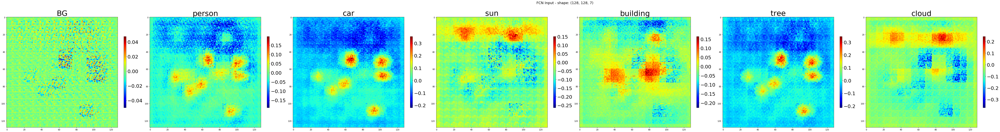

(1, 128, 128, 7)


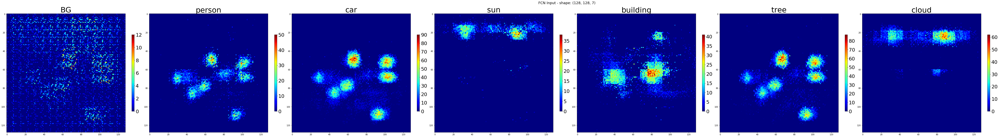

In [85]:
# vis2.display_fcn_input(fcn_model_pr_heatmap, class_names, cmap = 'jet')
vis2.display_fcn_output(fcn_model_fcn_heatmap, class_names, cmap = 'jet')
vis2.display_fcn_output(vis2.deprocess_image(fcn_model_fcn_heatmap), class_names, cmap = 'jet') 

#### display `model_pr_heatmap_scores`

In [15]:
model_pr_heatmap              = np.expand_dims(r['pr_hm'], 0)          # layer:  4   shape: (1, 128, 128, 7)
model_pr_heatmap_scores       = np.expand_dims(r['pr_hm_scores'], 0)   # layer:  5   shape: (1, 7, 64, 24)
print(model_pr_heatmap.shape ,model_pr_heatmap_scores.shape)
for i in range(7):
    print('CLASS : ', i, ' Sum of Heamap: ', model_pr_heatmap[0,:,:,i].sum())
    print(model_pr_heatmap_scores[0,i,:6])

(1, 128, 128, 7) (1, 7, 64, 24)
CLASS :  0  Sum of Heamap:  0.0
[[    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    60.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000
      0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    59.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000
      0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    58.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000
      0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    57.0000     0.0000     0.0000     0.0000     0.

--------------------------------------------------------------------------------------------------------------------------------------------------------------
                                                           alt score 0                     alt score 1                              alt score 2                
        class                   mrcnn   normlzd    gaussian    bbox   nrm.scr*     ga.sum     mask    score    norm         ga.sum    mask   score   norm     
seq  id     name                score    score       sum       area   gau.sum      in mask    sum             score        in mask    sum            score    
--------------------------------------------------------------------------------------------------------------------------------------------------------------
  0   6 cloud                  1.0000   1.0000     0.9882   936.0000  0.9882      48.6127    72.0000   0.6752   1.0000     48.6127    72.0000   0.6752   1.0000        87.00    30.50
  1   1 person        

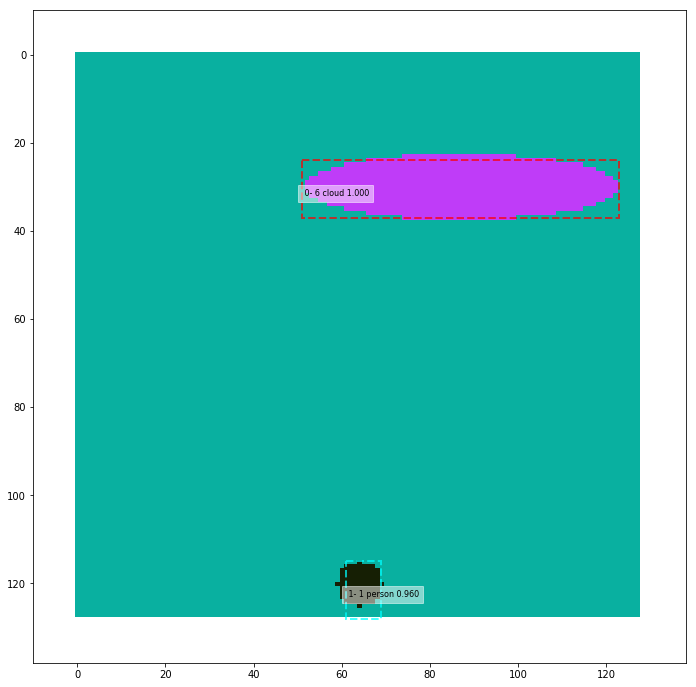

In [103]:
visualize.display_mrcnn_scores(r, class_names)

### manipulate heatmap

In [80]:
### Move from class to new class
from_cls = 2
to_cls   = 3
model_pr_heatmap[0,:,:,to_cls]    = model_pr_heatmap[0,:,:,from_cls]
model_pr_heatmap_scores[0,to_cls] = model_pr_heatmap_scores[0,from_cls]
model_pr_heatmap[0,:,:,from_cls] = 0
model_pr_heatmap_scores[0,from_cls] = 0
print(model_pr_heatmap.shape ,model_pr_heatmap_scores.shape)
for i in range(7):
    print('CLASS : ', i, ' Sum of Heamap: ', model_pr_heatmap[0,:,:,i].sum())
    print(model_pr_heatmap_scores[0,i,:5, :15])

(1, 128, 128, 7) (1, 7, 64, 24)
CLASS :  0  Sum of Heamap:  0.0
[[    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    61.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000
      0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    60.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000
      0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    59.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000
      0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    58.0000     0.0000     0.0000     0.0000     0.

In [73]:
from mrcnn.prep_notebook import run_fcn_only_detection
 
fcn_results2 = run_fcn_only_detection(fcn_model, dataset_test, [model_pr_heatmap, model_pr_heatmap_scores, model_image_meta], image_ids = [3], verbose = 1)
f2 = fcn_results2[0]

fcn_model_fcn_heatmap2         = np.expand_dims(f2['fcn_hm'], 0)          # layer:  4   shape: (1, 128, 128, 7)
fcn_model_fcn_heatmap_scores2  = np.expand_dims(f2['fcn_hm_scores'], 0)   # layer:  5   shape: (1, 7, 64, 24)

vis2.display_fcn_scores(f2['fcn_scores'], class_names)

Image Id  : 3     External Id: shapes.3     Image Reference: [('cloud', (191, 60, 248), (87, 30, 35, 7)), ('sun', (22, 31, 4), (64, 64, 5, 5))]
===> call fcn predict()
     pr_hm          (1, 128, 128, 7)
     pr_hm_scores   (1, 7, 64, 24)
     image_metas    (1, 15)
    results from fcn.keras_model.predict()
    Length of fcn_heatmaps :  1 (1, 128, 128, 7)
    Length of fcn_softmax  :  1 (1, 128, 128, 7)
    Length of fcn_hm_scores:  1 (1, 7, 64, 24)
   boxes_to_image_domain(): image_meta:  <class 'numpy.ndarray'> (15,)
 Process input/results  0
 pr_hm              : (128, 128, 7)
 pr_hm_scores       : (7, 64, 24)
 fcn_hm             : (128, 128, 7)
 fcn_hm_scores      : (7, 64, 24)
 fcn_scores_by_class: (7, 64, 24)
===> Return from fcn_model.detect_from_images() :  <class 'list'> 1 1
Image meta:  [         3        128        128          3          0          0        128        128          1          1]
 Length of results from MRCNN detect:  1
fcn_results keys: 
------------------

##  Load FCN Weight File

In [116]:
## BCE with original heatmap layer                 
# FCN_DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8L2_BCE/fcn20181224T0000'  
# FCN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20181224T0000' 
# fcn_files   = ['fcn_0001.h5', 'fcn_0150.h5', 'fcn_0346.h5', 'fcn_0421.h5',
#                'fcn_0450.h5', 'fcn_0521.h5', 'fcn_0687.h5', 'fcn_0793.h5',
#                'fcn_0821.h5', 'fcn_0940.h5', 'fcn_1012.h5', 'fcn_1127.h5',
#                'fcn_1644.h5', 'fcn_1776.h5', 'fcn_1848.h5', 'fcn_2017.h5','fcn_2084.h5']

## BCE with new heatmap layer                 
# FCN_DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8L2_BCE/fcn20180208T0000'  
FCN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000' 
fcn_files   = ['initialization', 
           'fcn_0001.h5', 'fcn_0003.h5', 'fcn_0005.h5', 'fcn_0009.h5',
           'fcn_0012.h5', 'fcn_0020.h5', 'fcn_0023.h5', 'fcn_0027.h5',
           'fcn_0033.h5', 'fcn_0047.h5', 'fcn_0070.h5', 'fcn_0080.h5',
           'fcn_0101.h5', 'fcn_0106.h5', 'fcn_0112.h5', 'fcn_0124.h5',
           'fcn_0138.h5', 'fcn_0144.h5', 'fcn_0161.h5', 'fcn_0171.h5', 'fcn_0181.h5']

# FCN_DIR_WEIGHTS =  '/home/kbardool/models_newshapes/train_fcn8L2_BCE2/fcn20190131T0000' 
# fcn_files   = ['fcn_0001.h5', 'fcn_0022.h5', 'fcn_0057.h5', 'fcn_0092.h5',
#                'fcn_0101.h5', 'fcn_0220.h5', 'fcn_0290.h5', 'fcn_0304.h5',
#                'fcn_0372.h5', 'fcn_0423.h5', 'fcn_0500.h5', 'fcn_0530.h5',
#                'fcn_0578.h5', 'fcn_0648.h5']

# FCN_DIR_WEIGHTS =  'F:/models_newshapes/train_fcn8L2_BCE2/fcn20190131T0000'  
# fcn_files   = ['fcn_0500.h5']


FILE_IDX = 13
fcn_weights_file = os.path.join(FCN_DIR_WEIGHTS  , fcn_files[FILE_IDX])
print("Loading weights ", fcn_weights_file)
fcn_model.load_model_weights(fcn_weights_file)

Loading weights  /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0101.h5
-----------------------------------------------
 Load Model with init parm: [ /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0101.h5 ]
-----------------------------------------------
 ---> Explicit weight file
>>> load_weights() from : /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0101.h5
    Weights file loaded: /home/kbardool/models_newshapes/train_fcn8L2_BCE/fcn20190208T0000/fcn_0101.h5 
FCN  MODEL Load weight file COMPLETE 


## Build Activation Model

### Model summary

In [23]:
# del fcn_mdl
fcn_model.keras_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_pr_hm_norm (InputLayer)   (None, 128, 128, 7)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 128, 128, 64) 4096        input_pr_hm_norm[0][0]           
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 128, 128, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 64, 64, 64)   0           block1_conv2[0][0]               
__________________________________________________________________________________________________
block2_con

### Build model that retrieves activations from `fcn_model` 

In [119]:
import keras.models as models   
def build_activation_model(model, layers):
    _ids = []
    _names = []
    for i, layer in enumerate(model.layers):
        if layer.name in layers:
            #  print(i, model.layers[i].name)
            _ids.append(i)
            _names.append(model.layers[i].name)

    # print(fcn_mdl.layers[2].output.shape)
    # print(fcn_mdl.layers[2].activation)
    # print(_ids)
    layer_outputs = [model.layers[i].output  for i in _ids]
    layer_names   = [model.layers[i].name    for i in _ids]

    activation_model = models.Model(inputs = model.input, outputs=layer_outputs)  
    activation_model.layer_names = _names
    activation_model.layer_ids   = _ids
    return activation_model

In [120]:
# my_layers = ['res5c_out','res4w_out', 'res3d_out', 'res2c_out', 'max_pooling2d_1', 'activation_1', 'bn_conv1', 'conv1']
# my_layers = ['block1_conv1', 'block1_conv2','block1_pool' , 'block2_conv1', 'block2_conv2', 'block2_pool']
# del my_layers, layer_outputs, layer_names, activation_model

my_layers = ['block1_pool' , 'block2_pool' , 'block3_pool',  
             'block4_conv1', 'block4_conv2',  'block4_conv3', 'block4_pool', 
             'block5_conv1', 'block5_conv2',  'block5_conv3', 'block5_pool', 
             'fcn32_deconv2D', 'fcn16_score2', 'fcn16_score_pool4', 'fcn16_fuse_pool4', 'fcn16_upscore_pool4',
             'fcn8_score_pool3' , 'fcn8_fuse_pool3' , 'fcn8_heatmap'] ## , 'fcn_softmax_lambda']

activation_model = build_activation_model(fcn_model.keras_model, my_layers) 

# print('activation_model.layer_ids:')
# print(activation_model.layer_ids)
# print('activation_model.layer_names:')
# print(activation_model.layer_names)

print('inputs:')
pp.pprint(activation_model.input)
print('outputs:')
pp.pprint(activation_model.output)
print('activation llayer names')
pp.pprint(activation_model.layer_names)
print('activation llayer ids')
pp.pprint(activation_model.layer_ids)

inputs:
[ <tf.Tensor 'input_pr_hm_norm:0' shape=(?, 128, 128, 7) dtype=float32>,
  <tf.Tensor 'input_pr_hm_scores:0' shape=(?, 7, 64, 24) dtype=float32>]
outputs:
[ <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 64, 64, 64) dtype=float32>,
  <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 32, 32, 128) dtype=float32>,
  <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 16, 16, 256) dtype=float32>,
  <tf.Tensor 'block4_conv1/Relu:0' shape=(?, 16, 16, 512) dtype=float32>,
  <tf.Tensor 'block4_conv2/Relu:0' shape=(?, 16, 16, 512) dtype=float32>,
  <tf.Tensor 'block4_conv3/Relu:0' shape=(?, 16, 16, 512) dtype=float32>,
  <tf.Tensor 'block4_pool/MaxPool:0' shape=(?, 8, 8, 512) dtype=float32>,
  <tf.Tensor 'block5_conv1/Relu:0' shape=(?, 8, 8, 512) dtype=float32>,
  <tf.Tensor 'block5_conv2/Relu:0' shape=(?, 8, 8, 512) dtype=float32>,
  <tf.Tensor 'block5_conv3/Relu:0' shape=(?, 8, 8, 512) dtype=float32>,
  <tf.Tensor 'block5_pool/MaxPool:0' shape=(?, 4, 4, 512) dtype=float32>,
  <tf.Tensor 'fcn32_deco


###  run image thru MRCNN detection

In [ ]:
IMAGE_ID = 27
# batch_x = prep.get_inference_batch(dataset_test, mrcnn_model.config, image_ids = IMAGE_ID, display= False)

results = run_mrcnn_detection(mrcnn_model, dataset_test, image_ids = IMAGE_ID, verbose = 0, display = True)
r = results[0]

pr_hm_scores:  (7, 64, 24)
pr_scores:  (12, 24)
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                          |   |                 |         alt score 0         |            alt score 1              |            alt score 2              |
        class             |TP/| mrcnn   normlzd |  gaussian   bbox   nrm.scr* |  ga.sum    mask     score   norm    |  ga.sum    mask     score   norm    |
seq  id name              | FP| score    score  |    sum      area   gau.sum  |  in mask   sum              score   |  in mask   sum              score   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 60   4 building          | 1 | 0.9999   1.0000 |  0.9324   217.0000  0.9324  |  21.3630   32.0000  0.6676  1.0000  |  21.3630   32.

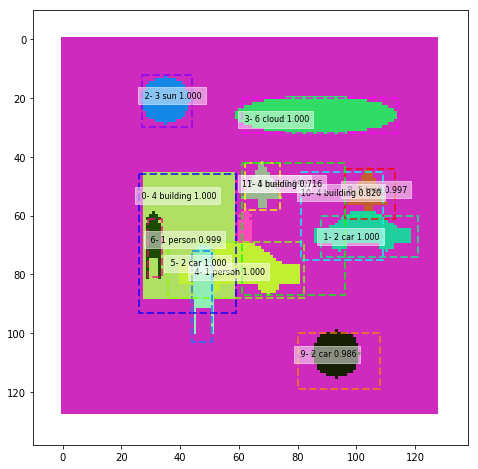

In [148]:
model_pr_heatmap              = np.expand_dims(r['pr_hm'], 0)          # layer:  4   shape: (1, 128, 128, 7)
model_pr_heatmap_scores       = np.expand_dims(r['pr_hm_scores'], 0)   # layer:  5   shape: (1, 7, 64, 24)
vis2.display_mrcnn_scores(r, class_names,)

In [136]:
print(r['pr_scores'])

[[   72.0000    44.0000   103.0000    51.0000     1.0000     0.9997     1.0000    60.0000     1.0000     0.9324   217.0000     0.9324    21.3630    32.0000     0.6676     1.0000     1.0000
      1.0000    21.3630    32.0000     0.6676     1.0000     1.0000     1.0000]
 [   61.0000    29.0000    81.0000    34.0000     1.0000     0.9992     1.0000    58.0000     0.9996     0.8726   100.0000     0.8722    16.7132    28.0000     0.5969     0.7823     0.8750
      0.8941    16.7132    28.0000     0.5969     0.7823     0.8750     0.8941]
 [   60.0000    88.0000    74.0000   121.0000     2.0000     0.9999     1.0000    63.0000     1.0000     0.9910   462.0000     0.9910    36.6115    54.0000     0.6780     0.7504     0.7714
      0.9728    36.6115    54.0000     0.6780     0.7504     0.7714     0.9728]
 [   69.0000    36.0000    88.0000    82.0000     2.0000     0.9996     1.0000    59.0000     0.9997     0.9978   874.0000     0.9975    48.7876    70.0000     0.6970     1.0000     1.0000
    

## Display Activation Filters

### Original input heatmaps to FCN

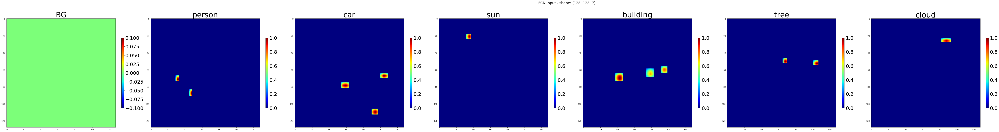

In [132]:
# display_final_activations_2(activations, layers)
import mrcnn.visualize_2 as vis2
vis2.display_fcn_input(model_pr_heatmap, class_names, cmap = 'jet')

### manipulate heatmap

####  CLEAR CLASS

In [37]:
### CLEAR CLASS
clear_cls = 1
empty_cls = 0
model_pr_heatmap[0,:,:,clear_cls] = model_pr_heatmap[0,:,:,empty_cls]
model_pr_heatmap_scores[0,clear_cls] = model_pr_heatmap_scores[0,empty_cls]
model_pr_heatmap[0,:,:,from_cls] = 0
model_pr_heatmap_scores[0,from_cls] = 0
print(model_pr_heatmap.shape ,model_pr_heatmap_scores.shape)
for i in range(7):
    print('CLASS : ', i, ' Sum of Heamap: ', model_pr_heatmap[0,:,:,i].sum())
    print(model_pr_heatmap_scores[0,i,:5, :15])

(1, 128, 128, 7) (1, 7, 64, 24)
CLASS :  0  Sum of Heamap:  0.0
[[ 0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000 61.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000]
 [ 0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000 60.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000]
 [ 0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000 59.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000]
 [ 0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000 58.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000]
 [ 0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000 57.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0.0000  0

#### MOVE ONE CLASS TO NEW CLASS

In [ ]:
from_cls = 2
to_cls   = 3
model_pr_heatmap[0,:,:,to_cls]    = model_pr_heatmap[0,:,:,from_cls]
model_pr_heatmap_scores[0,to_cls] = model_pr_heatmap_scores[0,from_cls]
model_pr_heatmap[0,:,:,from_cls] = 0
model_pr_heatmap_scores[0,from_cls] = 0c

In [100]:
print(model_pr_heatmap.shape ,model_pr_heatmap_scores.shape)
for i in range(7):
    print('CLASS : ', i, ' Sum of Heamap: ', model_pr_heatmap[0,:,:,i].sum())
    print(model_pr_heatmap_scores[0,i,:5,:15])

(1, 128, 128, 7) (1, 7, 64, 24)
CLASS :  0  Sum of Heamap:  0.0
[[    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    52.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    51.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    50.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    49.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    48.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]]
CLASS :  1  Sum of Heamap:  38.07621
[[   72.0000    44.0000   103.0000    51.0000     1.0000  

#### MOVE A BOUNDING BOX FROM  ONE CLASS TO NEW CLASS

In [149]:
print(model_pr_heatmap.shape ,model_pr_heatmap_scores.shape)
for i in range(7):
    print('CLASS : ', i, ' Sum of Heamap: ', model_pr_heatmap[0,:,:,i].sum())
    print(model_pr_heatmap_scores[0,i,:5,:15])

(1, 128, 128, 7) (1, 7, 64, 24)
CLASS :  0  Sum of Heamap:  0.0
[[    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    52.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    51.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    50.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    49.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    48.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]]
CLASS :  1  Sum of Heamap:  38.07621
[[   72.0000    44.0000   103.0000    51.0000     1.0000  

In [150]:
from_cls = 2
from_bbox = 2
to_cls   = 3
to_bbox = 1
y1 = int(model_pr_heatmap_scores[0,from_cls, from_bbox,0])
y2 = int(model_pr_heatmap_scores[0,from_cls, from_bbox,2])
x1 = int(model_pr_heatmap_scores[0,from_cls, from_bbox,1])
x2 = int(model_pr_heatmap_scores[0,from_cls, from_bbox,3])
print(y1,x1,y2,x2)
from_cls_mean =   model_pr_heatmap[0,:,:,from_cls].mean()
print(from_cls_mean)


100 80 119 108
0.007539446


In [151]:
model_pr_heatmap_scores[0,to_cls,to_bbox] = model_pr_heatmap_scores[0,from_cls,from_bbox]
model_pr_heatmap_scores[0,to_cls, to_bbox, 4] = to_cls
model_pr_heatmap_scores[0,to_cls, to_bbox, 6] = -1
model_pr_heatmap_scores[0,from_cls,from_bbox] = 0

In [152]:
model_pr_heatmap[0, y1:y2, x1:x2, to_cls] = model_pr_heatmap[0,y1:y2,x1:x2,from_cls]
model_pr_heatmap[0, y1:y2, x1:x2, from_cls] = from_cls_mean

In [153]:
print(model_pr_heatmap.shape ,model_pr_heatmap_scores.shape)
for i in range(7):
    print('CLASS : ', i, ' Sum of Heamap: ', model_pr_heatmap[0,:,:,i].sum())
    print(model_pr_heatmap_scores[0,i,:5,:15])

(1, 128, 128, 7) (1, 7, 64, 24)
CLASS :  0  Sum of Heamap:  0.0
[[    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    52.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    51.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    50.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    49.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
 [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000    48.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]]
CLASS :  1  Sum of Heamap:  38.07621
[[   72.0000    44.0000   103.0000    51.0000     1.0000  

### input heatmaps to FCN after manipulating the heatmaps (eg. moving one detection to another class)

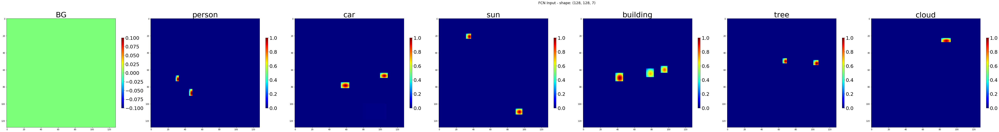

In [154]:
# display_final_activations_2(activations, layers)
import mrcnn.visualize_2 as vis2
vis2.display_fcn_input(model_pr_heatmap, class_names, cmap = 'jet')

In [155]:
from mrcnn.prep_notebook import run_fcn_only_detection
 
fcn_results2 = run_fcn_only_detection(fcn_model, dataset_test, [model_pr_heatmap, model_pr_heatmap_scores, model_image_meta], image_ids = [3], verbose = 1)
f2 = fcn_results2[0]

fcn_model_fcn_heatmap2         = np.expand_dims(f2['fcn_hm'], 0)          # layer:  4   shape: (1, 128, 128, 7)
fcn_model_fcn_heatmap_scores2  = np.expand_dims(f2['fcn_hm_scores'], 0)   # layer:  5   shape: (1, 7, 64, 24)

vis2.display_fcn_scores(f2['fcn_scores'], class_names)

Image Id  : 3     External Id: shapes.3     Image Reference: [('cloud', (191, 60, 248), (87, 30, 35, 7))]
===> call fcn predict()
     pr_hm          (1, 128, 128, 7)
     pr_hm_scores   (1, 7, 64, 24)
     image_metas    (1, 15)
    results from fcn.keras_model.predict()
    Length of fcn_heatmaps :  1 (1, 128, 128, 7)
    Length of fcn_softmax  :  1 (1, 128, 128, 7)
    Length of fcn_hm_scores:  1 (1, 7, 64, 24)
 Process input/results  0
 pr_hm              : (128, 128, 7)
 pr_hm_scores       : (7, 64, 24)
 fcn_hm             : (128, 128, 7)
 fcn_hm_scores      : (7, 64, 24)
 fcn_scores_by_class: (7, 64, 24)
===> Return from fcn_model.detect_from_images() :  <class 'list'> 1 1
Image meta:  [         3        128        128          3          0          0        128        128          1          1]
 Length of results from MRCNN detect:  1
fcn_results keys: 
--------------------
   fcn_hm...................  (128, 128, 7)
   fcn_hm_scores............  (7, 64, 24)
   fcn_scores.......

In [113]:
dp = vis2.normalize_fcn_hm(f2['fcn_hm'])
print(dp.shape)

print('     FCN_HM MIN      : ',f2['fcn_hm'].min(axis=(0,1)))
print('     FCN_HM MAX      : ',f2['fcn_hm'].max(axis=(0,1)))
print('     FCN_HM MEAN     : ',f2['fcn_hm'].mean(axis=(0,1)))
print('     FCN_HM STD DEV  : ',f2['fcn_hm'].std(axis=(0,1)))
print('     FCN_HM SUM      : ',f2['fcn_hm'].sum(axis=(0,1)))

print('NORM FCN_HM MIN      : ',dp.min(axis=(0,1)))
print('NORM FCN_HM MAX      : ',dp.max(axis=(0,1)))
print('NORM FCN_HM MEAN     : ',dp.mean(axis=(0,1)))
print('NORM FCN_HM STD      : ',dp.std(axis=(0,1)))
print('NORM FCN_HM SUM      : ',dp.sum(axis=(0,1)))
print(f2['fcn_hm_scores'][2,:2])

(128, 128, 7)
(128, 128, 7)
     FCN_HM MIN      :  [   -0.0500    -0.1916    -0.2203    -0.2650    -0.2270    -0.2148    -0.3717]
     FCN_HM MAX      :  [    0.0473     0.1976     0.3531     0.1506     0.1638     0.3440     0.2439]
     FCN_HM MEAN     :  [   -0.0007    -0.0324    -0.0225    -0.0471    -0.0221    -0.0208    -0.0556]
     FCN_HM STD DEV  :  [    0.0077     0.0417     0.0627     0.0409     0.0412     0.0545     0.0586]
     FCN_HM SUM      :  [  -10.7467  -530.6219  -368.8720  -771.3675  -362.7946  -340.0952  -910.4958]
NORM FCN_HM MIN      :  [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
NORM FCN_HM MAX      :  [    1.0000     1.0000     1.0000     1.0000     1.0000     1.0000     1.0000]
NORM FCN_HM MEAN     :  [    0.5073     0.4090     0.3450     0.5243     0.5242     0.3472     0.5135]
NORM FCN_HM STD      :  [    0.0793     0.1071     0.1093     0.0984     0.1055     0.0976     0.0951]
NORM FCN_HM SUM      :  [ 8311.9717  6700.761

In [156]:
dp = vis2.normalize_fcn_hm(f2['fcn_hm'])
print(dp.shape)

print('     FCN_HM MIN      : ',f2['fcn_hm'].min(axis=(0,1)))
print('     FCN_HM MAX      : ',f2['fcn_hm'].max(axis=(0,1)))
print('     FCN_HM MEAN     : ',f2['fcn_hm'].mean(axis=(0,1)))
print('     FCN_HM STD DEV  : ',f2['fcn_hm'].std(axis=(0,1)))
print('     FCN_HM SUM      : ',f2['fcn_hm'].sum(axis=(0,1)))

print('NORM FCN_HM MIN      : ',dp.min(axis=(0,1)))
print('NORM FCN_HM MAX      : ',dp.max(axis=(0,1)))
print('NORM FCN_HM MEAN     : ',dp.mean(axis=(0,1)))
print('NORM FCN_HM STD      : ',dp.std(axis=(0,1)))
print('NORM FCN_HM SUM      : ',dp.sum(axis=(0,1)))
print(f2['fcn_hm_scores'][2,:2])

(128, 128, 7)
(128, 128, 7)
     FCN_HM MIN      :  [   -0.0000    -1.5298    -1.4463    -1.0501    -1.3025    -0.8780    -1.3735]
     FCN_HM MAX      :  [    0.0000     0.2375     0.3753     0.3396     0.3197     0.6928     0.8112]
     FCN_HM MEAN     :  [   -0.0000    -0.2026    -0.1679    -0.1573    -0.1460    -0.1125    -0.1725]
     FCN_HM STD DEV  :  [    0.0000     0.2203     0.2171     0.1320     0.1898     0.1518     0.1719]
     FCN_HM SUM      :  [   -0.0000 -3320.0774 -2750.5720 -2577.0994 -2392.7336 -1843.3339 -2827.0217]
NORM FCN_HM MIN      :  [    0.0000     0.0000     0.0000     0.0000     0.0000     0.0000     0.0000]
NORM FCN_HM MAX      :  [    1.0000     1.0000     1.0000     1.0000     1.0000     1.0000     1.0000]
NORM FCN_HM MEAN     :  [    0.4897     0.7509     0.7018     0.6424     0.7129     0.4873     0.5497]
NORM FCN_HM STD      :  [    0.0628     0.1246     0.1192     0.0950     0.1170     0.0967     0.0787]
NORM FCN_HM SUM      :  [ 8023.2241 12303.361

In [114]:
print(f2['fcn_hm'].shape)
# print(f2['fcn_scores'])
dp = vis2.standardize_fcn_hm(f2['fcn_hm'])
print(dp.shape)
dp2 = vis2.normalize_fcn_hm(f2['fcn_hm'])
print(dp2.shape)
vis2.display_fcn_scores(f2['fcn_scores'], class_names) 
vis2.display_fcn_scores_box_info(f2['fcn_scores'], class_names, dp2)
print('\n'*2)
vis2.display_fcn_scores(f2['fcn_scores'], class_names) 
vis2.display_fcn_scores_box_info(f2['fcn_scores'], class_names, f2['fcn_hm'])

(128, 128, 7)
(128, 128, 7)
(128, 128, 7)
(128, 128, 7)
(128, 128, 7)

FCN_SCORES:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                             |         FCN score 0          |            FCN score 1                 |            FCN score 2              |
        class            TP  mrcnn   normlzd |  gaussian   bbox     nrm.scr*|  ga.sum    mask       score     norm   |  ga.sum    mask     score   norm    |
seq  id name             FP  score    score  |    sum      area     gau.sum |  in mask   sum                  score  |  in mask   sum              score   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 60   1 person           1  0.9997   1.0000  |    5.5770     217     5.5770 |    2.3356      3

In [157]:
print(f2['fcn_hm'].shape)
# print(f2['fcn_scores'])
dp = vis2.standardize_fcn_hm(f2['fcn_hm'])
print(dp.shape)
dp2 = vis2.normalize_fcn_hm(f2['fcn_hm'])
print(dp2.shape)
vis2.display_fcn_scores(f2['fcn_scores'], class_names) 
vis2.display_fcn_scores_box_info(f2['fcn_scores'], class_names, dp2)
print('\n'*2)
vis2.display_fcn_scores(f2['fcn_scores'], class_names) 
vis2.display_fcn_scores_box_info(f2['fcn_scores'], class_names, f2['fcn_hm'])

(128, 128, 7)
(128, 128, 7)
(128, 128, 7)
(128, 128, 7)
(128, 128, 7)

FCN_SCORES:
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                                             |         FCN score 0          |            FCN score 1                 |            FCN score 2              |
        class            TP  mrcnn   normlzd |  gaussian   bbox     nrm.scr*|  ga.sum    mask       score     norm   |  ga.sum    mask     score   norm    |
seq  id name             FP  score    score  |    sum      area     gau.sum |  in mask   sum                  score  |  in mask   sum              score   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 60   1 person           1  0.9997   1.0000  |   11.6275     217    11.6275 |    5.8154      3

 FCN INput


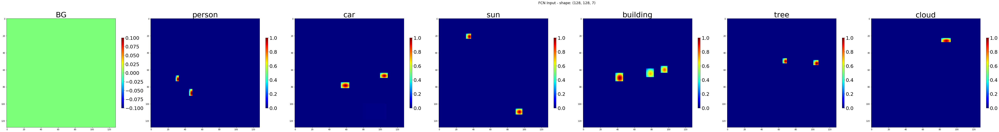

FCN Output


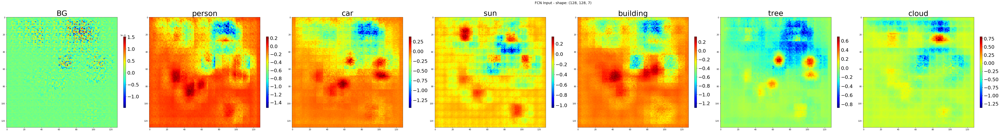

FCN Output - DEPROCESSED
(1, 128, 128, 7)


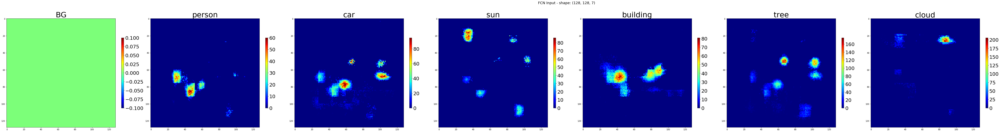

FCN Output - NORMALIZED
(1, 128, 128, 7)


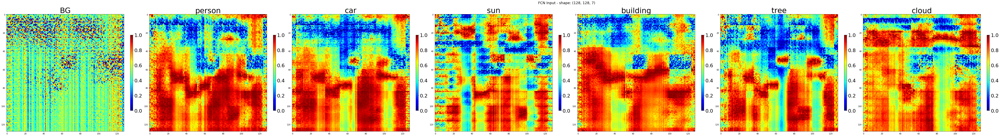

FCN Output - STANDARDIZED
(1, 128, 128, 7)


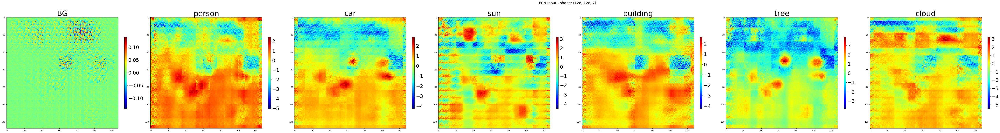

In [165]:
# vis2.display_fcn_input(fcn_model_pr_heatmap, class_names, cmap = 'jet')
print(' FCN INput')
vis2.display_fcn_input(model_pr_heatmap, class_names, cmap = 'jet')
print('FCN Output')
vis2.display_fcn_output(fcn_model_fcn_heatmap2, class_names, cmap = 'jet')
print('FCN Output - DEPROCESSED')
vis2.display_fcn_output(vis2.deprocess_image(fcn_model_fcn_heatmap2), class_names, cmap = 'jet') 
print('FCN Output - NORMALIZED')
vis2.display_fcn_output(vis2.normalize_fcn_hm(fcn_model_fcn_heatmap2), class_names, cmap = 'jet') 

print('FCN Output - STANDARDIZED')
vis2.display_fcn_output(vis2.standardize_fcn_hm(fcn_model_fcn_heatmap2), class_names, cmap = 'jet') 
# vis2.display_fcn_output(normalize_fcn_hm(fcn_model_fcn_heatmap2), class_names, cmap = 'jet') 

In [77]:
# x = np.transpose(fcn_model_fcn_heatmap2[0],(2,0,1))
# x.mean(axis=0).shape
x = fcn_model_fcn_heatmap2.mean(axis=(1,2), keepdims = True)
y = fcn_model_fcn_heatmap2.std(axis=(1,2), keepdims = True)
print(x.shape,y.shape)

(1, 1, 1, 7) (1, 1, 1, 7)


In [129]:
# def standardize_fcn_hm(x):
#     # normalize tensor: center on 0., ensure std is 0.1
#     print(x.shape)
#     out = x - x.mean(axis=(0,1), keepdims = True)
#     out /= (x.std(axis=(0,1), keepdims = True) + 1e-7)
#     return out

# def normalize_fcn_hm(x):
#     # normalize tensor: center on 0., ensure std is 0.1
#     print(x.shape)
#     out = x - x.min(axis=(0,1), keepdims = True)
#     out /= (x.max(axis=(0,1), keepdims = True) - x.min(axis=(0,1), keepdims = True))
#     return out

### run activation model on image

In [159]:

activations = activation_model.predict([model_pr_heatmap, model_pr_heatmap_scores])


### display final activation layers

[11, 12, 13, 14, 15, 16, 17, 18]
Layer: 11  -  fcn32_deconv2D    Shape:  (4, 4, 7)  # features:  7 8 1
Layer: 12  -  fcn16_score2    Shape:  (10, 10, 7)  # features:  7 8 1
Layer: 13  -  fcn16_score_pool4    Shape:  (8, 8, 7)  # features:  7 8 1
Layer: 14  -  fcn16_fuse_pool4    Shape:  (8, 8, 7)  # features:  7 8 1
Layer: 15  -  fcn16_upscore_pool4    Shape:  (16, 16, 7)  # features:  7 8 1
Layer: 16  -  fcn8_score_pool3    Shape:  (16, 16, 7)  # features:  7 8 1
Layer: 17  -  fcn8_fuse_pool3    Shape:  (16, 16, 7)  # features:  7 8 1
Layer: 18  -  fcn8_heatmap    Shape:  (128, 128, 7)  # features:  7 8 1


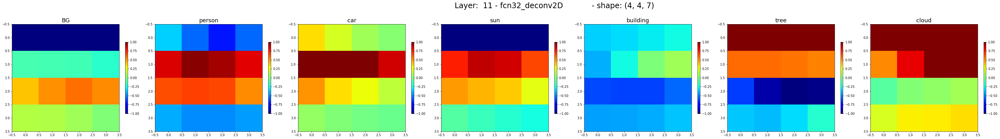

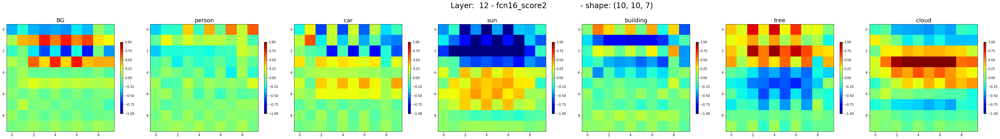

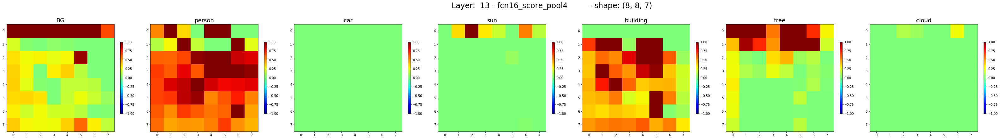

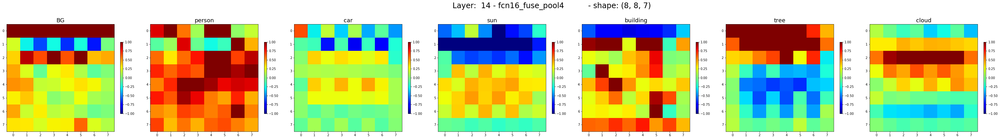

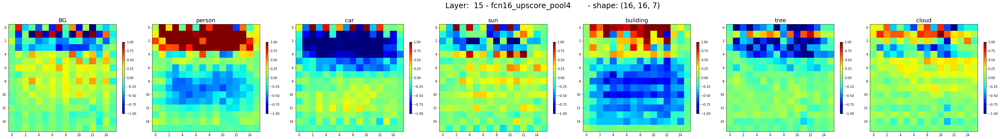

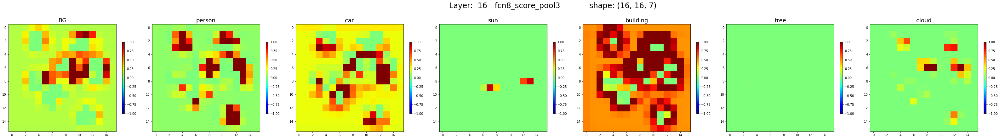

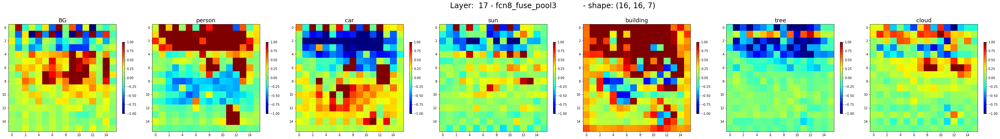

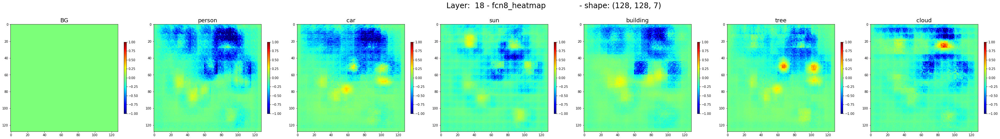

In [160]:
 # display_activations(activations,9, columns = 3)
layers = list(range(len(activations)-8, len(activations)))
print(layers)
vis2.display_final_activations(activations, layers, activation_model.layer_names, class_names, columns = 8)

### Display argmax of fcn_softmax

In [161]:
np_format = {}
np_format['float'] =  lambda x: "%10.4f" % x
np_format['int']   =  lambda x: "%10d" % x
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)

In [162]:
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =100000)
# sm =  fcn_results[0]['fcn_sm']
layer_id = -1
sm = activations[layer_id]
nm = activation_model.layer_names[layer_id]
print(nm, 'shape: ', sm.shape)
# print(sm[0, 12:28, 12:28, 3])
print()
print(sm[0, 54:74, 54:74, 3])    ## <-- Y is second dimesnion

# sm_2 = activations[-2]
# nm_2 = activation_model.layer_names[-2]
# print(nm_2, 'shape: ', sm_2.shape)
# print(sm_2[0, 12:28, 12:28, 3])

cls_min  = np.min(sm, axis = (1,2))
cls_max  = np.max(sm, axis = (1,2))
# arg_max1 = np.argmax(sm, axis = (1,2))
arg_max = np.argmax(sm, axis = -1)
arg_min = np.argmin(sm, axis = -1)
print('Layer : ', nm, ' Cls_max2 Shape: ',arg_max.shape, arg_min.shape, cls_min.shape)
print('cls min: ', cls_min)
print('cls max: ', cls_max)
# print(sm[:,7:20,28:30,:].sum(axis=(0,1,2)))
print('SM sum : ' , sm.sum(axis=(0,1,2)))
print(sm[:,6:20,17:35,:].sum(axis=(0,1,2)))
print('\narg_max')
print(utils.mask_string(arg_max))
print('\narg_min')
print(utils.mask_string(arg_min))
dataset_test.display_active_class_info()
print()


fcn8_heatmap shape:  (1, 128, 128, 7)

[[-0.2494 -0.3427 -0.4076 -0.4330 -0.3510 -0.3263 -0.4560 -0.5096 -0.3324 -0.3292 -0.3838 -0.4505 -0.3482 -0.2646 -0.5934 -0.4861 -0.2994 -0.5616 -0.7800 -0.6752]
 [-0.2734 -0.3339 -0.4427 -0.4072 -0.3147 -0.4522 -0.4914 -0.4326 -0.4145 -0.4556 -0.5220 -0.3494 -0.2272 -0.4465 -0.5748 -0.6088 -0.2380 -0.5038 -0.7954 -0.5021]
 [-0.3285 -0.4477 -0.4145 -0.4436 -0.4320 -0.3497 -0.5219 -0.4855 -0.3592 -0.5567 -0.4258 -0.3927 -0.3845 -0.2414 -0.4999 -0.4817 -0.3834 -0.6577 -0.5800 -0.5133]
 [-0.3107 -0.3194 -0.4697 -0.3640 -0.3389 -0.3274 -0.4005 -0.6330 -0.3838 -0.4633 -0.5466 -0.3887 -0.2882 -0.3016 -0.3584 -0.4163 -0.5667 -0.3339 -0.6601 -0.4746]
 [-0.3091 -0.4192 -0.4065 -0.3798 -0.3897 -0.2757 -0.3507 -0.6035 -0.5513 -0.7512 -0.4493 -0.4322 -0.3303 -0.2025 -0.3850 -0.3743 -0.3116 -0.5428 -0.5006 -0.4629]
 [-0.3000 -0.3567 -0.3384 -0.3791 -0.2361 -0.3436 -0.6984 -0.4658 -0.4166 -0.6301 -0.3769 -0.4804 -0.1716 -0.5185 -0.5892 -0.3959 -0.3435 -0.3841 

### Display Activations by layer

#### Display Activations Group 1 : `Block1_pool`


Layer: 0  -  block1_pool    Shape:  (64, 64, 64)  # features:  64 8 8


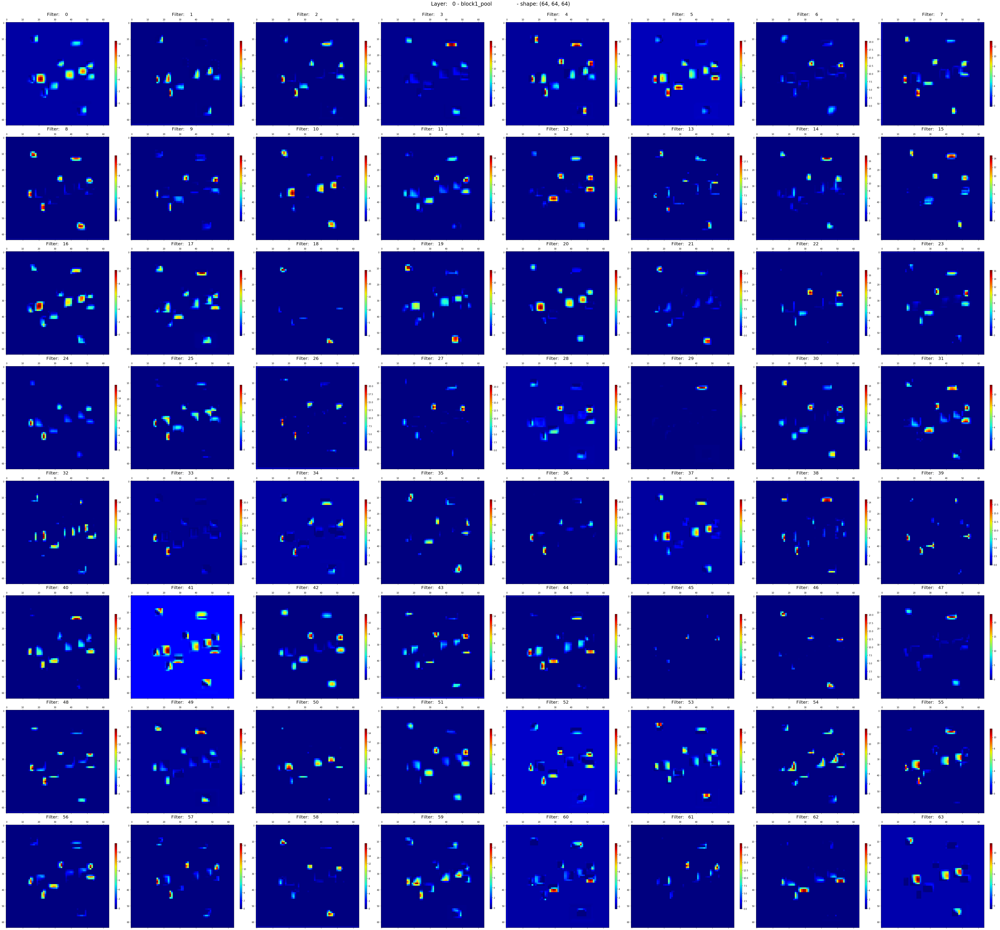

In [163]:
 vis2.display_activations(activations, 0,activation_model.layer_names, class_names)

#### Display Activations Group 2

../..\mrcnn\visualize_2.py:246: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= c_std


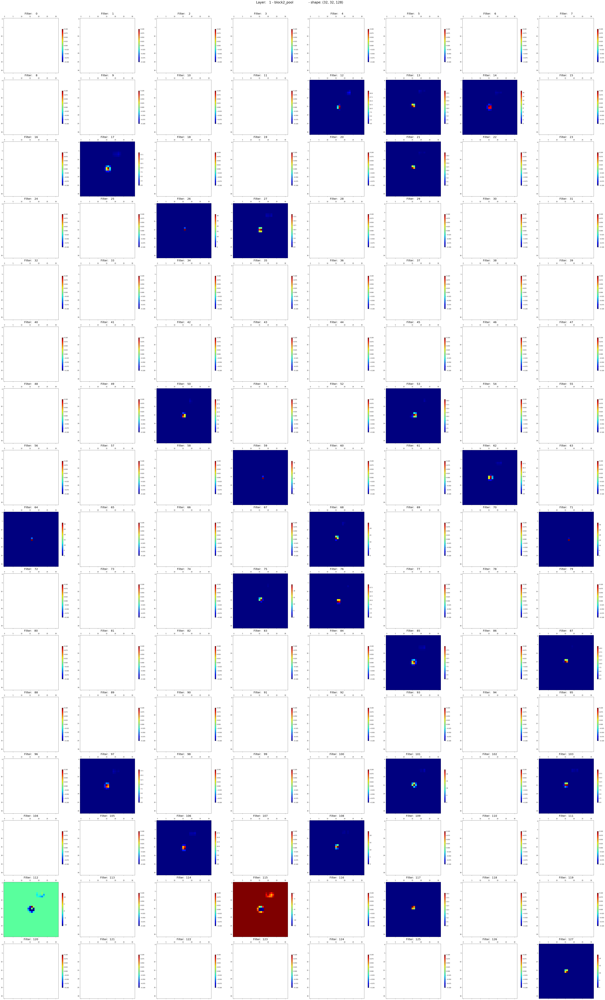

In [90]:
vis2.display_activations(activations,1 ,activation_model.layer_names, class_names)

#### Display Activations Group 3

In [107]:
vis2.display_activations(activations,2,activation_model.layer_names, class_names)

../..\mrcnn\visualize_2.py:246: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= c_std


#### Display Activations Group 4

In [164]:
vis2.display_activations(activations,3,activation_model.layer_names, class_names)


Layer: 3  -  block4_conv1    Shape:  (16, 16, 512)  # features:  512 64 8


../../mrcnn/visualize_2.py:245: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= c_std


#### Display Activations Group 5

In [109]:
vis2.display_activations(activations,4,activation_model.layer_names, class_names)

../..\mrcnn\visualize_2.py:246: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= c_std


#### Display Activations Group 6

In [110]:
vis2.display_activations(activations,5,activation_model.layer_names, class_names)


Layer: 5  -  block4_conv3    Shape:  (16, 16, 512)  # features:  512 64 8


../..\mrcnn\visualize_2.py:245: RuntimeWarning: invalid value encountered in true_divide
  channel_image -= c_mean


#### Display Activations Group 7

In [111]:
vis2.display_activations(activations,6,activation_model.layer_names, class_names, normalize = False)


Layer: 6  -  block4_pool    Shape:  (8, 8, 512)  # features:  512 64 8


#### Display Activations Group 8

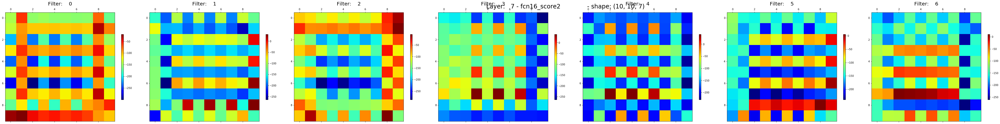

In [390]:
vis2.display_activations(activations,7,activation_model.layer_names, class_names)

#### Display Activations layer 9

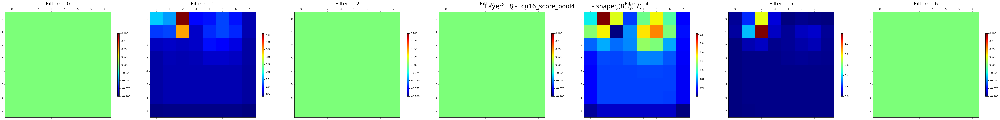

In [108]:
vis2.display_activations(activations, 8, ,activation_model.layer_names, class_names, normalize = False)

#### Display Activations Group 10

In [ ]:
vis2.display_activations(activations, 9, ,activation_model.layer_names, class_names, normalize = False)

#### Display Activations Group 11

In [ ]:
vis2.display_activations(activations, 10, ,activation_model.layer_names, class_names, normalize = False)

### Display Activations 

block1_pool  layer_activation:  (1, 64, 64, 64)  n_features:  64   size:  64 sclae:  0.015625   display_gird.shape  (512, 512)  n_rows:  8 ratio:  1.0
   Figure size: 8.0  by  8.0
block2_pool  layer_activation:  (1, 32, 32, 128)  n_features:  128   size:  32 sclae:  0.03125   display_gird.shape  (512, 256)  n_rows:  16 ratio:  0.5
   Figure size: 4.0  by  8.0
block3_pool  layer_activation:  (1, 16, 16, 256)  n_features:  256   size:  16 sclae:  0.0625   display_gird.shape  (512, 128)  n_rows:  32 ratio:  0.25

D:\Program Files\Anaconda3\envs\TF\lib\site-packages\ipykernel\__main__.py:28: RuntimeWarning: invalid value encountered in true_divide



   Figure size: 2.0  by  8.0
block4_pool  layer_activation:  (1, 8, 8, 512)  n_features:  512   size:  8 sclae:  0.125   display_gird.shape  (512, 64)  n_rows:  64 ratio:  0.125
   Figure size: 1.0  by  8.0
block5_conv1  layer_activation:  (1, 8, 8, 512)  n_features:  512   size:  8 sclae:  0.125   display_gird.shape  (512, 64)  n_rows:  64 ratio:  0.125
   Figure size: 1.0  by  8.0


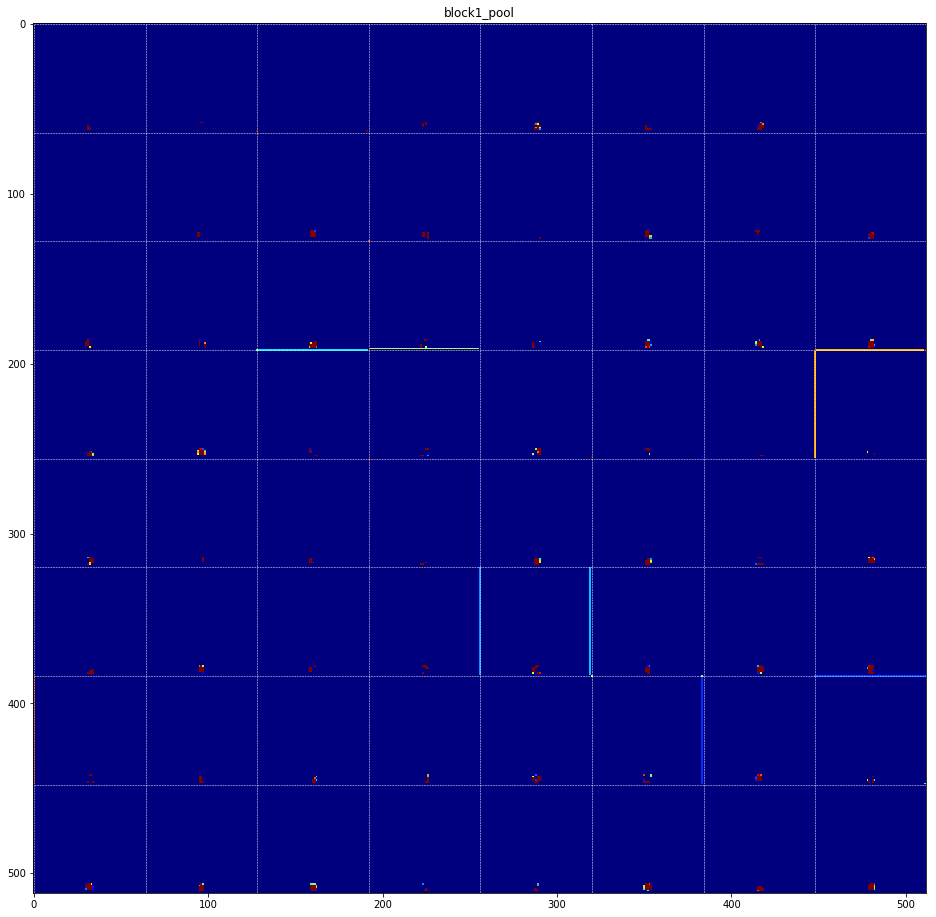

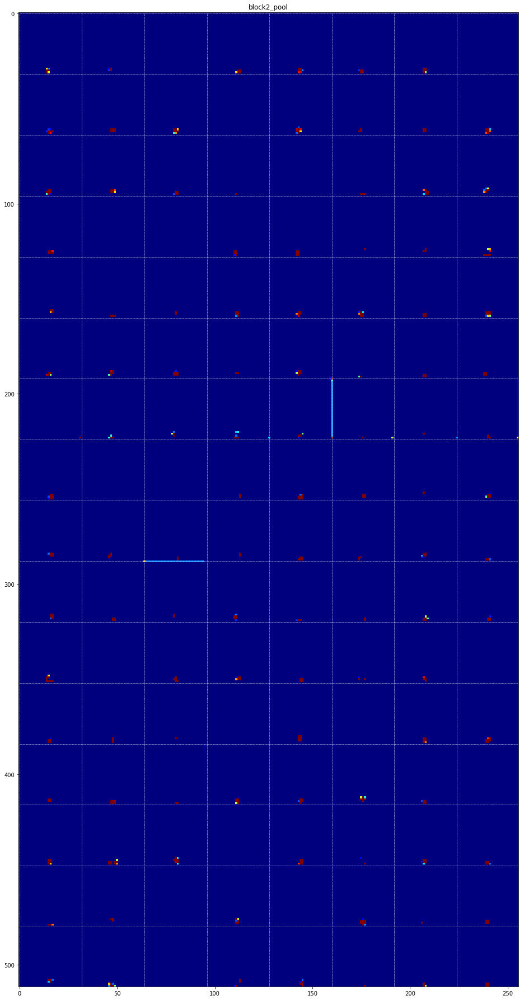

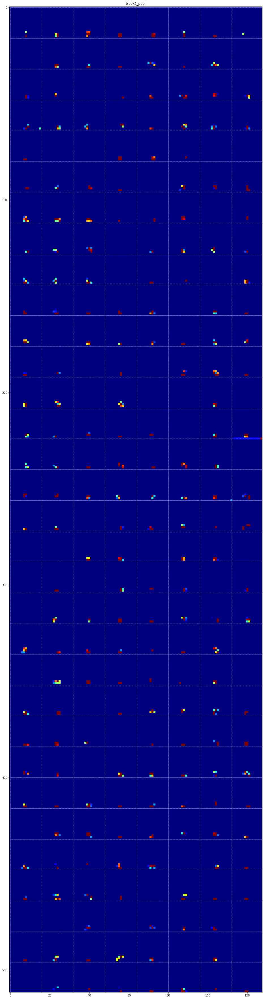

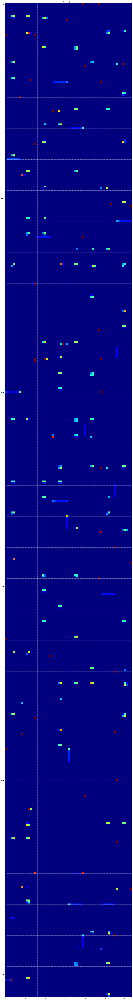

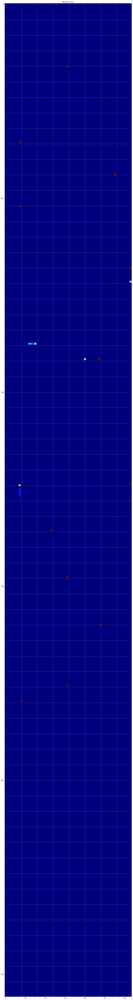

In [142]:
# layer_names = []
# for layer in model.layers[2:11]:
#     layer_names.append(layer.name)
images_per_row = 8
for layer_name, layer_activation in zip(layer_names[:], activations[:5]):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_rows = n_features // images_per_row
    scale = 1./size
    ratio = images_per_row/n_rows
    
    display_grid = np.zeros((size * n_rows,  size * images_per_row ))
    
    print(layer_name, ' layer_activation: ' , layer_activation.shape, ' n_features: ', n_features, '  size: ', size, 'sclae: ', scale,'  display_gird.shape ', display_grid.shape, ' n_rows: ', n_rows, 'ratio: ', ratio)
    print('   Figure size:', scale * display_grid.shape[1] *ratio, ' by ', scale * display_grid.shape[1])
    
    for row in range(n_rows):
        for col in range(images_per_row):
            
            channel_image = layer_activation[0,:,:, row * images_per_row + col]
            c_min  = channel_image.min()
            c_max  = channel_image.max()
            c_mean = channel_image.mean()
            c_std  = channel_image.std()
            
            ## Normalize to mean 0 , std_dev = 1
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image -= 128
            
#             a_min  = channel_image.min()
#             a_max  = channel_image.max()
#             a_mean = channel_image.mean()
#             a_std  = channel_image.std()
            
#             print(' channel:{:4d}    min: {:9.4f}   max: {: 9.4f}   BEFORE mean:{:8.4f}  std:{:8.4f}'.format(
#                         col*images_per_row+row,c_min, c_max, c_mean, c_std))
            channel_image = np.clip(channel_image,0,255).astype('uint8')
            display_grid[(row*size): (row+1)*size, (col*size):(col+1)*size] = channel_image
                   
            
            
            
#     scale  = 1.
#     plt.figure(figsize = (scale * display_grid.shape[1]*ratio, scale * display_grid.shape[1]))
    plt.figure(figsize = (16, 16/ratio))
    plt.title(layer_name)
#     plt.grid(True)
    for xval in np.linspace(0.0,   display_grid.shape[1], images_per_row+1 ):
#         print('xval:', xval)
        plt.vlines(xval, 0.0,   display_grid.shape[0], color='white', alpha=1, linestyles='dashed', linewidth=.5)
    
    for yval in np.linspace(0.0,   display_grid.shape[0], n_rows+1 ):
#         print('yval:', yval)        
        plt.hlines(yval, 0.0,   display_grid.shape[1], color='white', alpha=1, linestyles='dashed', linewidth=.5)
    
    plt.imshow(display_grid, aspect='auto', cmap='jet')
    

### Display Activations - adding a margin between filters 

In [ ]:
# layer_names = []
# for layer in model.layers[2:11]:
#     layer_names.append(layer.name)
images_per_row = 8
margin = 5
for layer_name, layer_activation in zip(layer_names[:], activations[:3]):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_rows = n_features // images_per_row
    scale = 1./size
    ratio = images_per_row/n_rows
    
    display_grid = np.zeros((n_rows * size + (n_rows-1) * margin, images_per_row * size + (images_per_row -1) * margin))
    display_grid += 128
#     display_grid = np.zeros((size * n_rows,  size * images_per_row ))


    
    print(layer_name, ' layer_activation: ' , layer_activation.shape, ' n_features: ', n_features, '  size: ', size, 'sclae: ', scale,'  display_gird.shape ', display_grid.shape , ' n_rows: ', n_rows, 'ratio: ', ratio)
    
    for row in range(n_rows):
        for col in range(images_per_row):
            
            channel_image = layer_activation[0,:,:, row * images_per_row + col]
            c_min  = channel_image.min()
            c_max  = channel_image.max()
            c_mean = channel_image.mean()
            c_std  = channel_image.std()
            
            ## Normalize to mean 0 , std_dev = 1
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image -= 128
            
#             a_min  = channel_image.min()
#             a_max  = channel_image.max()
#             a_mean = channel_image.mean()
#             a_std  = channel_image.std()
            
#             print(' channel:{:4d}    min: {:9.4f}   max: {: 9.4f}   BEFORE mean:{:8.4f}  std:{:8.4f}'.format(
#                         col*images_per_row+row,c_min, c_max, c_mean, c_std))

            channel_image = np.clip(channel_image,0,255).astype('uint8')
    
            horizontal_start = row * size + row * margin
            horizontal_end = horizontal_start + size
            vertical_start = col * size + col * margin
            vertical_end = vertical_start + size
#             print('horiz st/end:', horizontal_start, horizontal_end, '   Vertical st/en:', vertical_start, vertical_end)
            
            display_grid[horizontal_start: horizontal_end, vertical_start: vertical_end] = channel_image
#             display_grid[(row*size): (row+1)*size, (col*size):(col+1)*size] = channel_image
                   
            
            
            
#     print( ' Type 1 fig size: ', scale * display_grid.shape[1]*ratio, scale * display_grid.shape[1])
#     plt.figure(figsize = (scale * display_grid.shape[1]*ratio, scale * display_grid.shape[1]))
    print( ' Type 1 fig size: ',  scale * display_grid.shape[1], scale * display_grid.shape[1])
    plt.figure(figsize = ( scale * display_grid.shape[1], scale * display_grid.shape[1]))

#     print( ' Type 2 fig size: ', 16 , ' by ' , 16/ratio)
#     plt.figure(figsize = (16, 16/ratio))
    plt.title(layer_name)
#     plt.grid(True)
#     for xval in np.linspace(0.0,   display_grid.shape[1], images_per_row+1 ):
# #         print('xval:', xval)
#         plt.vlines(xval, 0.0,   display_grid.shape[0], color='white', alpha=1, linestyles='dashed', linewidth=.5)
    
#     for yval in np.linspace(0.0,   display_grid.shape[0], n_rows+1 ):
# #         print('yval:', yval)        
#         plt.hlines(yval, 0.0,   display_grid.shape[1], color='white', alpha=1, linestyles='dashed', linewidth=.5)
    
    plt.imshow(display_grid, aspect='auto', cmap = 'bwr')
    

## Visualizing the filters


Display the visual pattern that each filter is meant to respond to. This can be done with gradient ascent in input space: applying gradient descent to the value of the input image of a convnet so as to maximize the response of a specific filter, starting from a blank input image. The resulting input image would be one that the chosen filter is maximally responsive to.

The process is simple: we will build a loss function that maximizes the value of a given filter in a given convolution layer, then we will use stochastic gradient descent to adjust the values of the input image so as to maximize this activation value. 

Source: https://github.com/fchollet/deep-learning-with-python-notebooks/blob/master/5.4-visualizing-what-convnets-learn.ipynb

In [26]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

def generate_pattern(layer_name, filter_index, size=128, iterations = 40, step = 1):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = KB.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = KB.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (KB.sqrt(KB.mean(KB.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = KB.function(model.input, [loss, grads])
    
    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 7)) * 20 + 128.
    inp2 = np.zeros((0,7,64,24), dtype = np.float)
    print(' model input: ', model.input)
    print('layer_output: ', layer_output)
    print('        loss: ', loss)
    print('       grads: ', grads)
    
    # Run gradient ascent for 40 steps
    #     step = 1.
    for i in range(iterations):
        loss_value, grads_value = iterate([input_img_data, inp2])
        grads_sum = np.sum(grads_value)
        if i % 100 == 0 :
            print(i, 'loss: ', loss_value, np.sum(input_img_data, axis= (0,1,2)), grads_sum,  np.sum(grads_value, axis= (0,1,2)))        
        if (grads_sum == 0):
            print(' grads_sum is zero ', grads_sum,' i ',i)
            break
        input_img_data += grads_value * step
        
    img = input_img_data
#     return deprocess_image(img)
    return img

 model input:  [<tf.Tensor 'input_pr_hm_norm:0' shape=(?, 128, 128, 7) dtype=float32>, <tf.Tensor 'input_pr_hm_scores:0' shape=(?, 7, 64, 24) dtype=float32>]
layer_output:  Tensor("fcn8_heatmap/BiasAdd:0", shape=(?, 128, 128, 7), dtype=float32)
        loss:  Tensor("Mean_8:0", shape=(), dtype=float32)
       grads:  Tensor("truediv_4:0", shape=(?, 128, 128, 7), dtype=float32)
(1, 128, 128, 7)


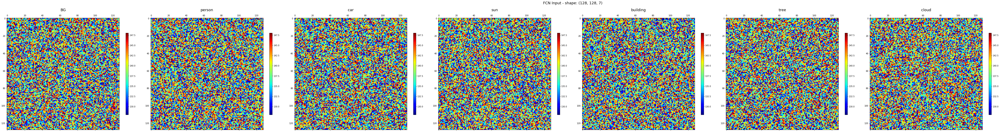

In [12]:
import keras.backend as KB
import mrcnn.visualize_2 as vis2
# layer_name = 'block3_conv1'
# layer_name = 'fcn8_fuse_pool3'
model = fcn_model.keras_model
LAYER_NAME = 'fcn8_heatmap'
LAYER_FILTER_INDEX = 3
layer_output = model.get_layer(LAYER_NAME).output
loss = KB.mean(layer_output[:,:,:,LAYER_FILTER_INDEX])
grads = KB.gradients(loss, model.input)[0]

# Normalization trick: we normalize the gradient
grads /= (KB.sqrt(KB.mean(KB.square(grads))) + 1e-5)
print(' model input: ', model.input)
print('layer_output: ', layer_output)
print('        loss: ', loss)
print('       grads: ', grads)


iterate = KB.function(model.input, [loss, grads])
inp1 = np.zeros((1,128,128,7))
inp2 = np.zeros((1,7,64,24))
loss_value, grads_value = iterate([inp1, inp2])

input_img_data = np.random.random((1,128,128,7))*20 + 128
inp2 = np.zeros((0,7,64,24))
print(input_img_data.shape)
# plt.imshow(input_img_data[0,:,:,0], cmap = 'gray')
vis2.display_fcn_input(input_img_data, class_names)

In [22]:
step = 1.
# input_img_data = np.random.random((1,128,128,7))*20 + 128
# inp2 = np.zeros((0,7,64,24))
# sav_grads_val = np.zeros(7)

for i in range(1000):
    loss_val, grads_val = iterate([input_img_data, inp2])
     
    if i % 100 == 0 :
        print(i, 'loss: ', loss_val, np.sum(input_img_data, axis= (0,1,2)), np.sum(grads_val, axis= (0,1,2)))
    input_img_data += grads_val * step

print('finished')
print('--------')
print(i, 'loss: ', loss_val, np.sum(input_img_data, axis= (0,1,2)), np.sum(grads_val, axis= (0,1,2)))    

0 loss:  -0.3473646 [8928.4287 8548.9028 8547.9384 5012.336  8554.0453 9436.4286 8315.9201] [    90.2171   2694.6067    591.8157   1103.4816   2166.774  -11859.079    3125.8372]
100 loss:  4.503663 [ 12019.1549  44767.5495  -5342.4367 147024.394  -13485.0762 -97628.2119 -14819.5051] [ 104.1269  512.495  -349.8737 1655.0096 -419.44   -961.8581 -459.5756]
200 loss:  12.060257 [  19813.1418  104441.2667  -35895.7463  319301.7859  -53251.9193 -202940.5643  -43401.3862] [  146.8781  1011.8481  -265.5291  1129.1133  -431.1898 -1118.0629   -39.9569]
300 loss:  20.318138 [  27537.3765  169668.2423  -68750.9654  497807.6466  -93656.1921 -311557.9631  -70732.6169] [  -22.9108    84.9923  -387.813   2360.9558  -347.5884 -1194.5674  -321.5202]
400 loss:  28.690874 [  34860.6557  235083.5645 -102387.1373  680455.4758 -134250.1092 -420980.1078  -98350.7861] [  109.5411   836.8714  -249.1083  1692.7532  -391.6801 -1071.4591  -257.9803]
500 loss:  37.15284 [  42015.2112  301616.1255 -135597.0845  8639

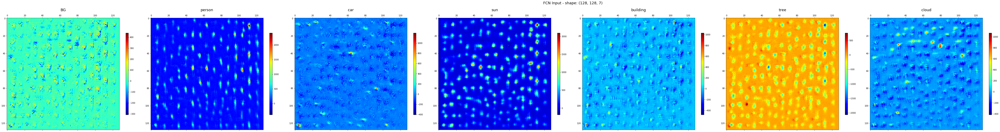

In [23]:
vis2.display_fcn_input(input_img_data, class_names, cmap = 'jet')

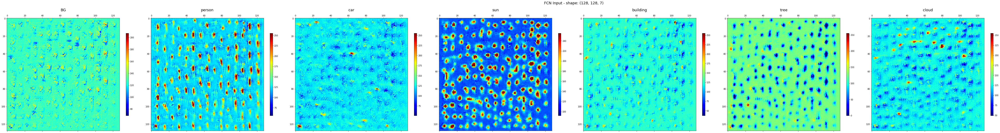

In [24]:
vis2.display_fcn_input(deprocess_image(input_img_data), class_names, cmap = 'jet')

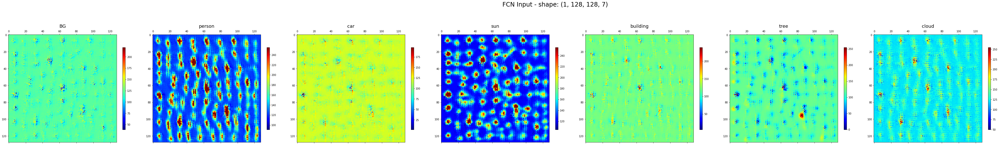

In [34]:
display_fcn_input(deprocess_image(input_img_data), cmap = 'jet')

In [ ]:
for layer_name in ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results)
    plt.show()

In [377]:
# img = generate_pattern('block5_conv1', 390, iterations = 1000, step = 1)   ## 247, 390, 451, 499
img = generate_pattern('fcn8_fuse_pool3', 0, iterations = 1000, step = 1)   ## 247, 390, 451, 499

 model input:  [<tf.Tensor 'input_pr_hm_norm:0' shape=(?, 128, 128, 7) dtype=float32>, <tf.Tensor 'input_pr_hm_scores:0' shape=(?, 7, 64, 24) dtype=float32>]
layer_output:  Tensor("block5_conv1/Relu:0", shape=(?, 8, 8, 512), dtype=float32)
        loss:  Tensor("Mean_121:0", shape=(), dtype=float32)
       grads:  Tensor("truediv_56:0", shape=(?, 128, 128, 7), dtype=float32)
0 loss:  43.461185 [2259457.7034 2261310.5251 2260628.7418 2261044.3999 2261563.3078 2260128.1995 2260769.5398] 9753.759 [  363.2920 12571.3096 -2121.8000  3768.1511 -1445.7841 -6336.4038  2954.9246]
100 loss:  1963.2423 [2191104.8591 2049615.6711 2149643.0942 2604014.7925 2246003.2764 2099721.7742 2192878.0817] -5923.529 [-1268.7792 -4696.6372  -469.3380  5682.3340  -556.5505 -3887.5671  -727.0173]
200 loss:  4658.5894 [2073891.7726 1747172.6959 2045368.0477 3229738.6073 2138622.2080 1598643.2190 2180128.6205] -4111.251 [ -934.8995 -1493.1831 -1923.7072  6430.8350 -1420.1899 -5029.7056   259.6141]
300 loss:  7440.

(1, 128, 128, 7)


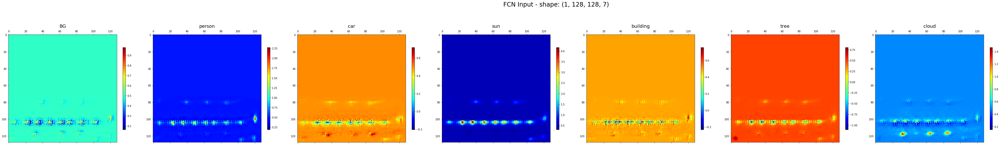

In [373]:
print(img.shape)
display_fcn_input(img, cmap = 'jet')

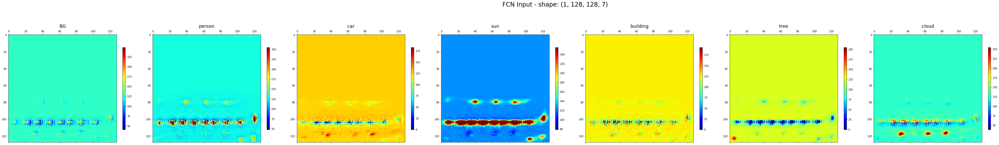

In [374]:
display_fcn_input(deprocess_image(img), cmap = 'jet')

## Display Heatmaps

### 2D Plots  

####  2D plot of `model_gt_heatmap` returned from model

 Image Id:  0  Display classes: [0, 1, 25, 31, 32]
 rows   2  columns : 3
 min_z_all shape: ()  min_z_all: -0.058524482  max_z_all: () max_z_all: 1.1999353
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


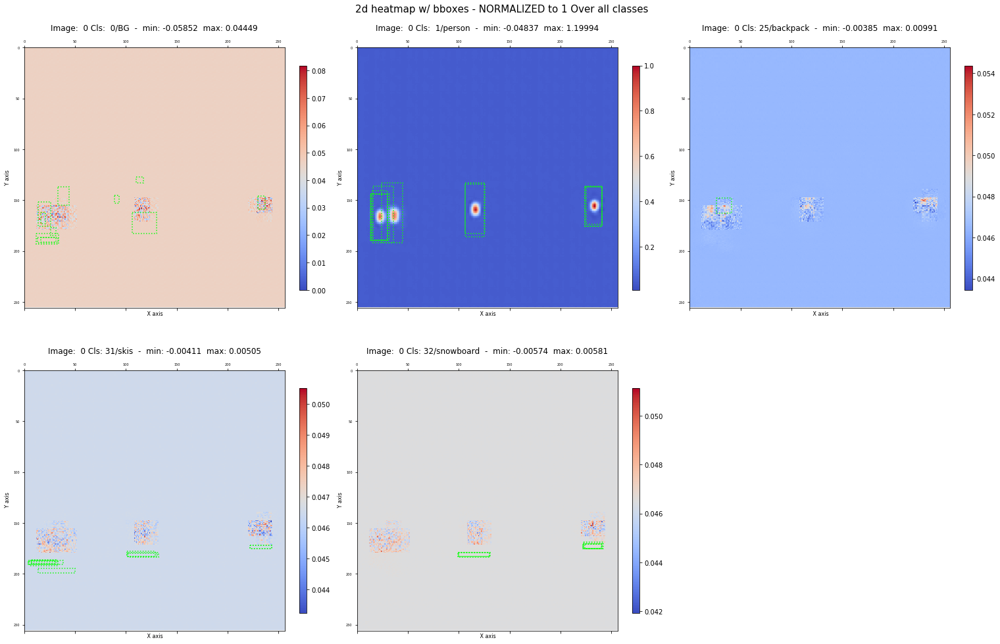

In [140]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3,
                          class_names = coco_class_names, scale = 4, scaling = 'all')

 Image Id:  0  Display classes: [0, 1, 31]
 rows   1  columns : 3
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


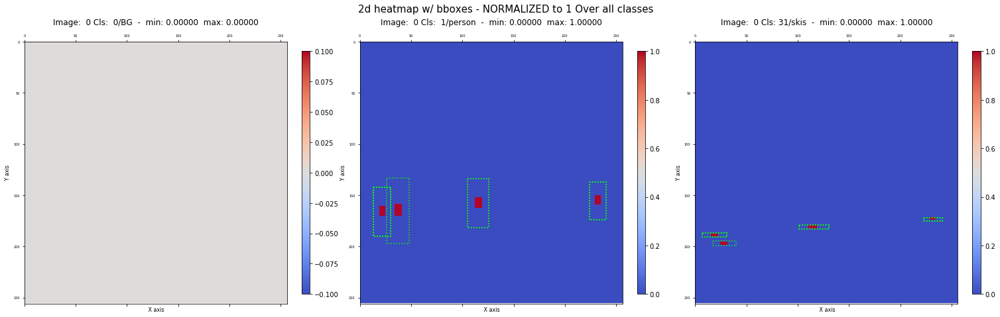

In [138]:
fig = visualize.plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, gt_class_ids, 
                          class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

####  2D plot of `pred_heatmap_norm` returned from MRCNN 

 Image Id:  0  Display classes: [0, 1, 25, 31, 32]
 rows   2  columns : 3
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


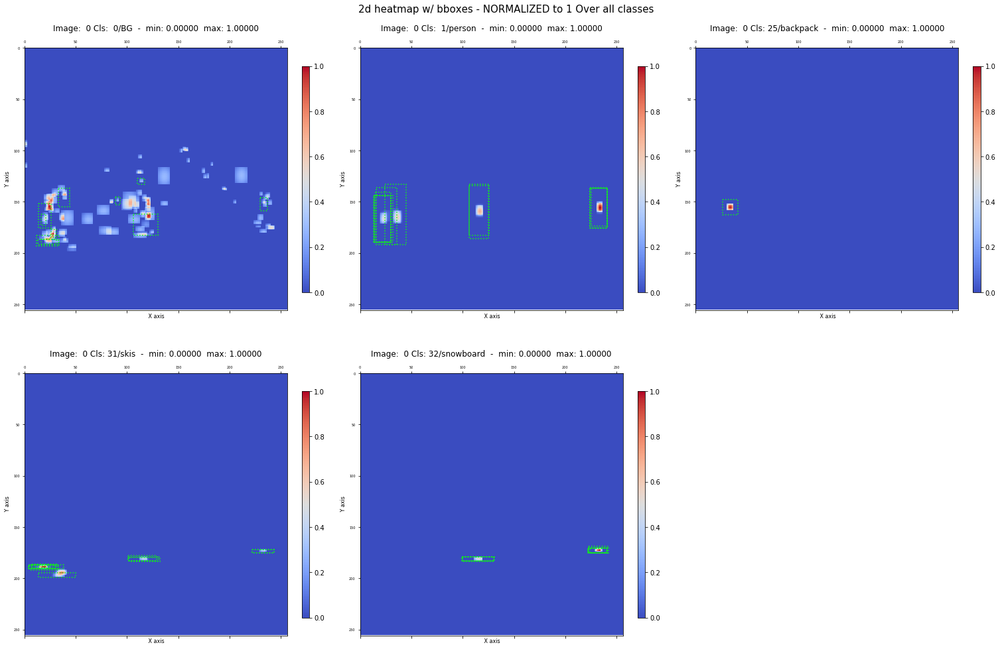

In [141]:
fig = visualize.plot_2d_heatmap(model_pr_heatmap, model_pr_heatmap_scores, img_id, pr_class_ids, columns = 3, 
                            class_names = coco_class_names, scale = 4, scaling = 'all')

####  2D plot of `model_fcn_heatmap` returned from model

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

 Image Id:  0  Display all classes...
 rows   27  columns : 3
 min_z_all shape: ()  min_z_all: -0.058524482  max_z_all: () max_z_all: 1.1999353
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all


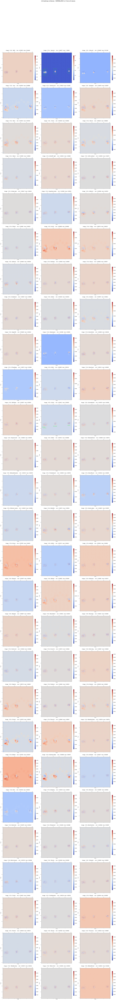

In [142]:
fig = visualize.plot_2d_heatmap(model_fcn_heatmap, model_gt_heatmap_scores, img_id,
                                class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

In [ ]:
fig.savefig('fcn_heatmaps_2d.png')

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

Display classes: [0, 1, 2, 3, 10]


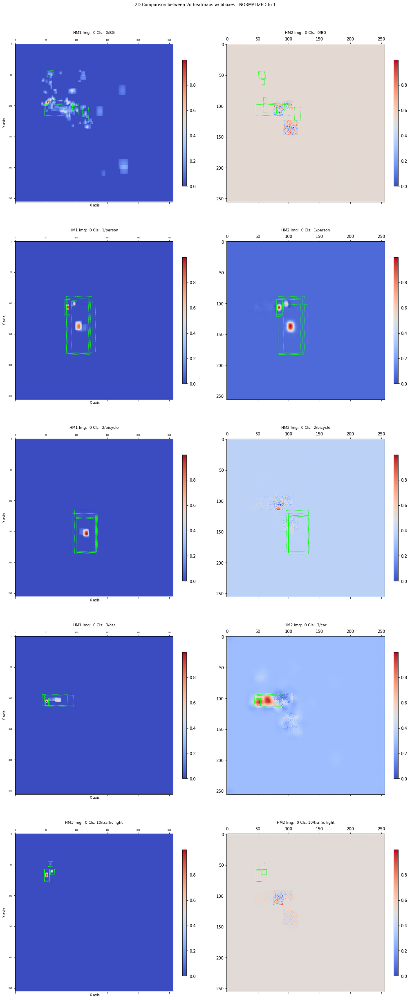

In [20]:
fig = visualize.plot_2d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, model_pr_heatmap_scores, 
                        img_id, class_ids = pr_class_ids, class_names = coco_class_names, scale = 4, scaling = True )    

###  3D Plots

####  3D plot of  `gt_heatmap_norm` returned form code above

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
zlim = all   zlim_min : 0.00000000 zlim_max: 1.00000000 
 SCALING == class


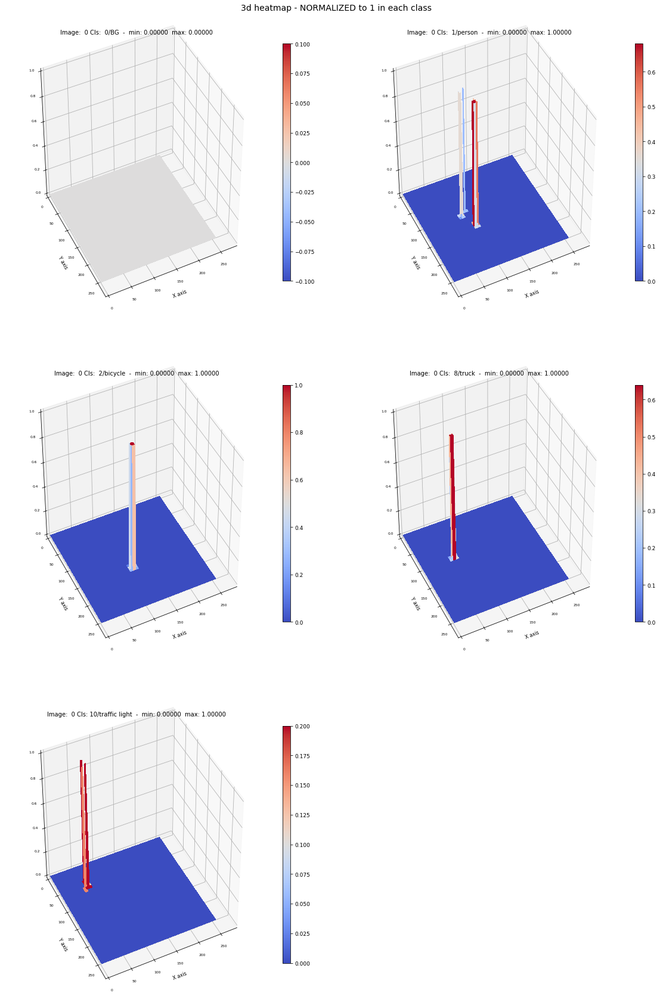

In [34]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap(model_gt_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling='class')

####  3D plot of `pred_heatmap_norm` returned form model

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 
1 zlim = each  zlim_min : 0.00000000 zlim_max: 1.00000000 


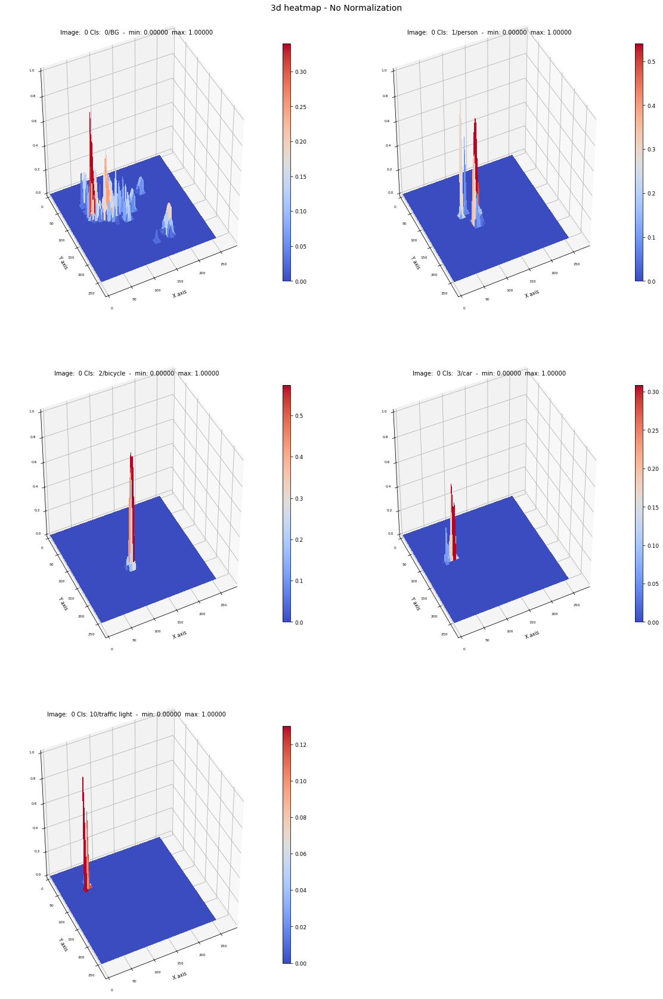

In [38]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_pr_heatmap, img_id, pr_class_ids, class_names = coco_class_names, zlim = 'class' , scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - only classes in pred_scores

1.0054814 -0.07213605
Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display classes: [0, 1, 2, 3, 10]
rows   3  columns : 2
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
1 zlim = each  zlim_min : -0.04918735 zlim_max: 0.04423909 
1 zlim = each  zlim_min : -0.07213605 zlim_max: 1.00548136 
1 zlim = each  zlim_min : -0.00786482 zlim_max: 0.01213216 
1 zlim = each  zlim_min : -0.00898363 zlim_max: 0.02093699 
1 zlim = each  zlim_min : -0.00705333 zlim_max: 0.00658484 


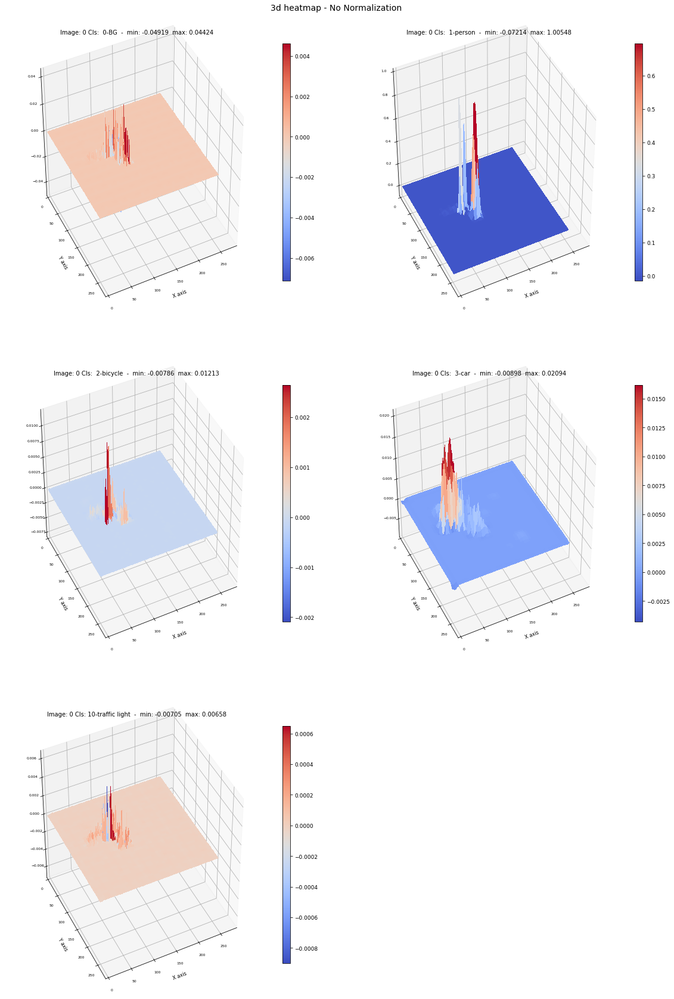

In [44]:
print(np.max(model_fcn_heatmap), np.min(model_fcn_heatmap))

print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, pr_class_ids,class_names = coco_class_names, scaling = 'none')

####  3D plot of `fcn_heatmap` returned form model - all classes

Image : 0  ClassIds: [0, 1, 2, 3, 10]
Display all classes...
rows   21  columns : 4
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == all
zlim = all   zlim_min : -0.07213605 zlim_max: 1.00548136 


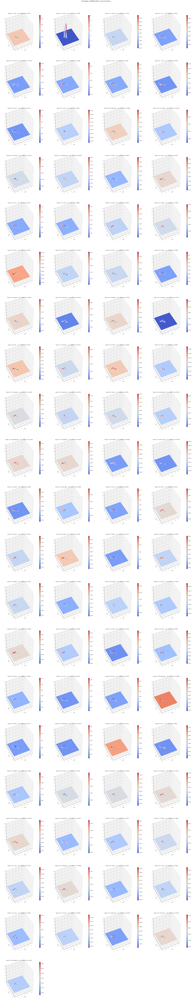

In [45]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
#     plot_3d_heatmap(model_fcn_heatmap, img_id, class_ids,class_names = class_names, size = (8,8), zlim=0)
visualize.plot_3d_heatmap(model_fcn_heatmap, img_id, class_names = coco_class_names, columns = 3,scaling = 'all')

####  3D comparative display `pred_heatmap` / `fcn_heatmap` 

In [ ]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
visualize.plot_3d_heatmap_compare(model_pr_heatmap, model_fcn_heatmap, img_id, class_ids = pr_class_ids, 
                            class_names = coco_class_names, size=(8,8), zlim = 'all' , scaling = 'all')

####  3D comparative display `gt_heatmap` / `fcn_heatmap` 

Image : 0  ClassIds: [0, 1, 2, 8, 10]
Display classes: [0, 1, 2, 8, 10]
 image height/width  256 256
shape pos  (256, 256, 2) shape Z1:  (256, 256, 81) shape Z2: (256, 256, 81)
 min_z1_all shape: ()  min_z1_all: 0.0  max_z1_all: () max_z1_all: 1.0
 min_z2_all shape: ()  min_z2_all: -0.07213605  max_z2_all: () max_z2_all: 1.0054814
 min_z_all shape: ()  min_z_all: -0.07213605  max_z_all: () max_z_all: 1.0054814
 min_z1_cls shape: (1, 1, 81)  max_z1_cls shape: (1, 1, 81)
 min_z2_cls shape: (1, 1, 81)  max_z2_cls shape: (1, 1, 81)
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
ttl:  HM1 Img:  0 Cls:  0/BG  -  min: 0.00000  max: 0.00000
ttl:  HM2 Img:  0 Cls:  0/BG  -  min: -0.04919  max: 0.04424
ttl:  HM1 Img:  0 Cls:  1/person  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  1/person  -  min: -0.07214  max: 1.00548
ttl:  HM1 Img:  0 Cls:  2/bicycle  -  min: 0.00000  max: 1.00000
ttl:  HM2 Img:  0 Cls:  2/bicycle  -  min: -0.00786  max: 0.01213
ttl:  HM1 Img:  0 Cls:  8/t

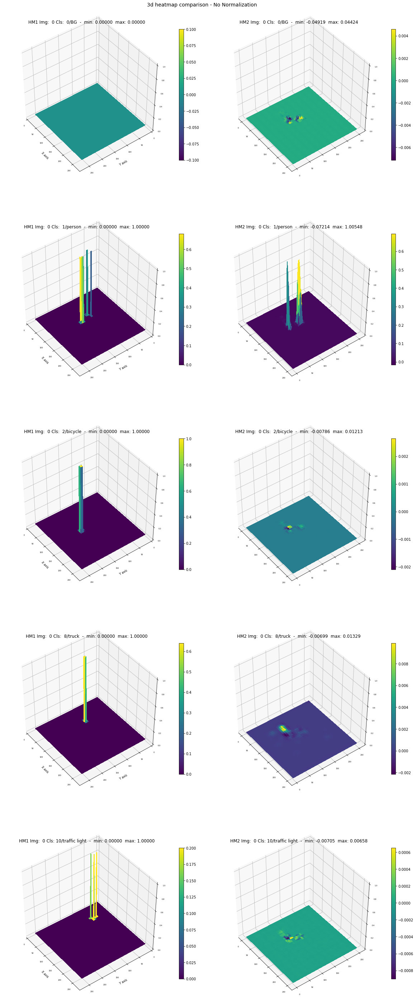

In [73]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_3d_heatmap_compare(model_gt_heatmap, model_fcn_heatmap, img_id, gt_class_ids, class_names = coco_class_names, scaling = 'none')

### Overlay predictions on image

#### Overlay image with gt_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1  2  8 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


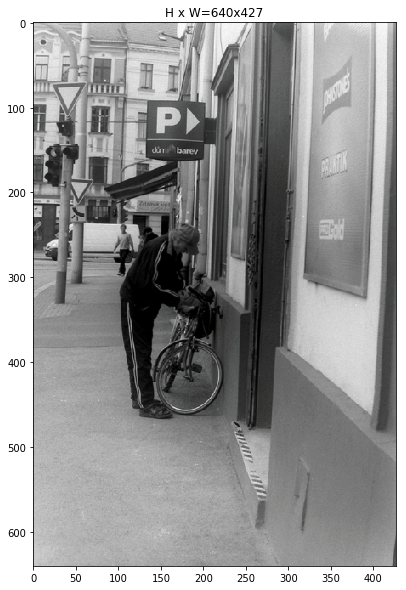

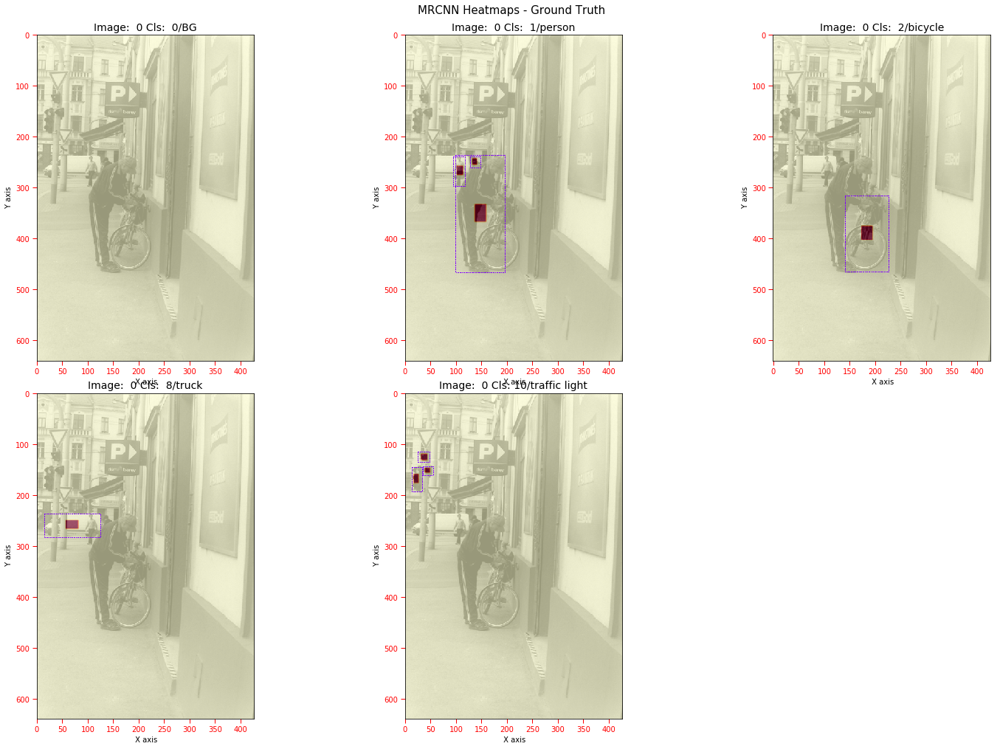

In [75]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'gt', columns = 3, 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names)

#### Overlay image with pred_heatmaps

Image shape : (1024, 1024, 3)  class_ids: [ 0  1  2  3 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


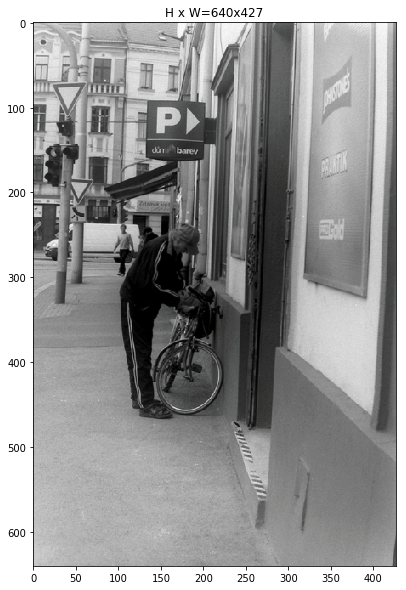

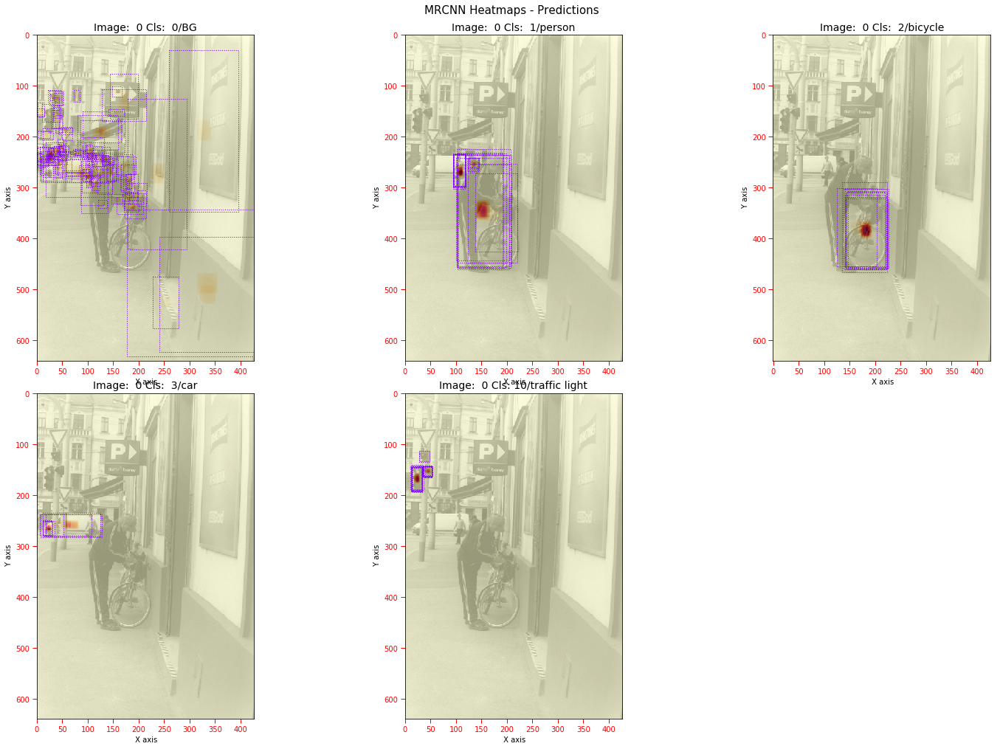

In [76]:
visualize.display_heatmaps_mrcnn(mrcnn_input, mrcnn_output, 0, hm = 'pr', columns = 3,
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names)

#### Overlay image with fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


 min_z_all:  () -0.07213605  max_z_all : () 1.0054814
 SCALING == none (clip to [-1, +1])
 Title:  Img: 0 Cls:  0/BG  -  min: -0.04919  max: 0.04424
 Title:  Img: 0 Cls:  1/person  -  min: -0.07214  max: 1.00000
 Title:  Img: 0 Cls:  2/bicycle  -  min: -0.00786  max: 0.01213
 Title:  Img: 0 Cls:  8/truck  -  min: -0.00699  max: 0.01329
 Title:  Img: 0 Cls: 10/traffic light  -  min: -0.00705  max: 0.00658


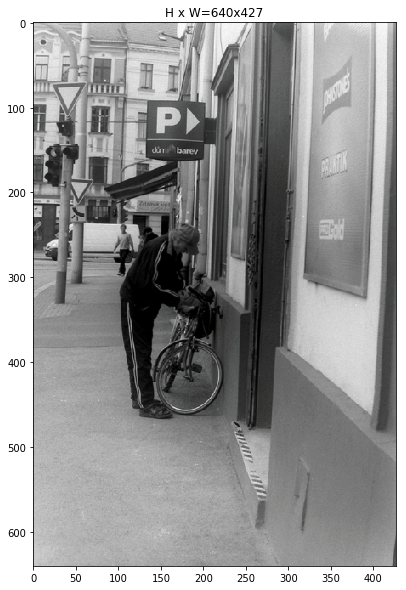

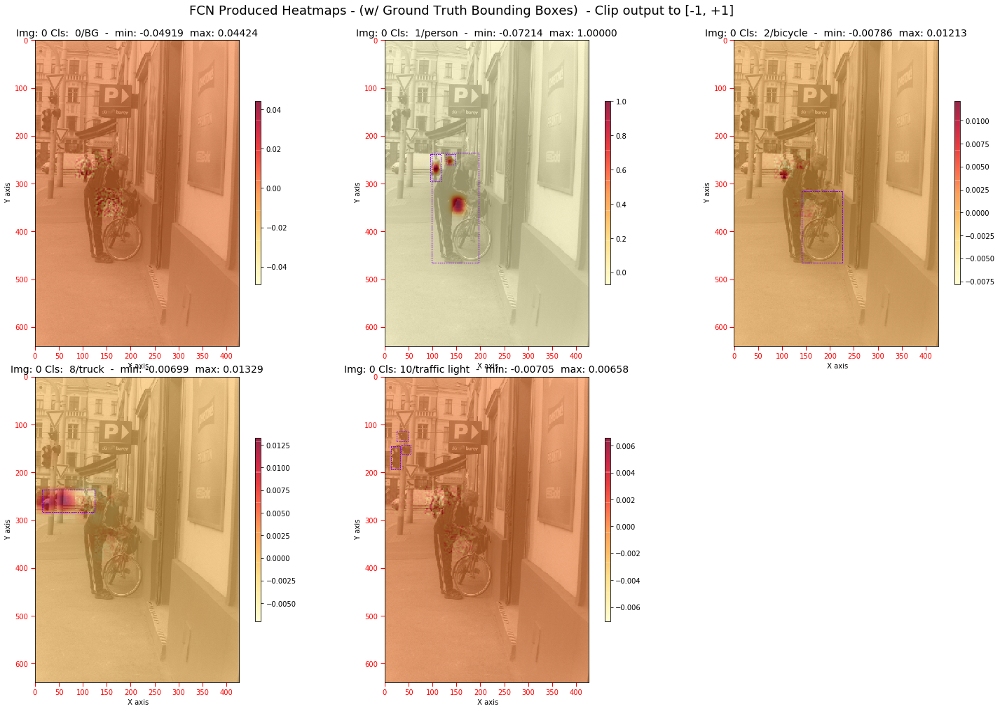

In [106]:
visualize.display_heatmaps_mrcnn_fcn(mrcnn_input, mrcnn_output, 0, heatmap = model_fcn_heatmap, hm = 'gt', columns = 3,
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'clip')

In [94]:
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: center;
}
</style>
""")

#### Overlay image with gt_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


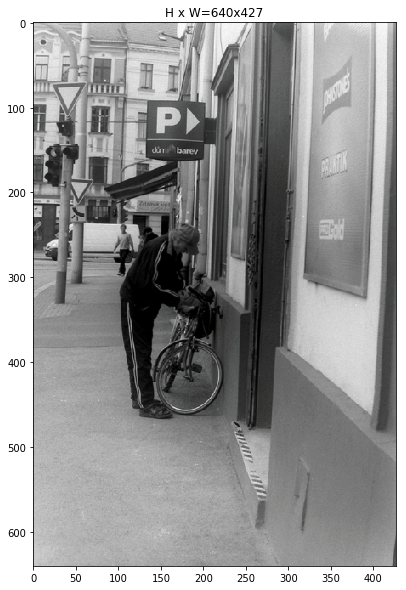

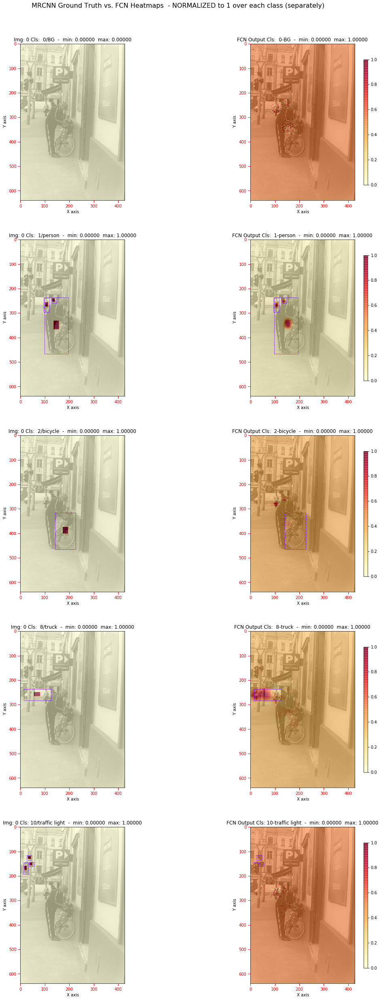

In [119]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, 
                                   hm = 'gt', config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')

#### Overlay image with pr_heatmaps and fcn_heatmaps

 Bounding boxes shape:  (81, 200, 11)
Image shape : (1024, 1024, 3)  class_ids: [0, 1, 2, 8, 10]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\util\dtype.py:130: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


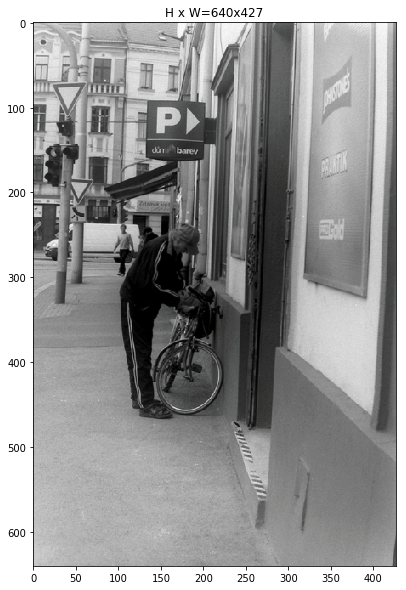

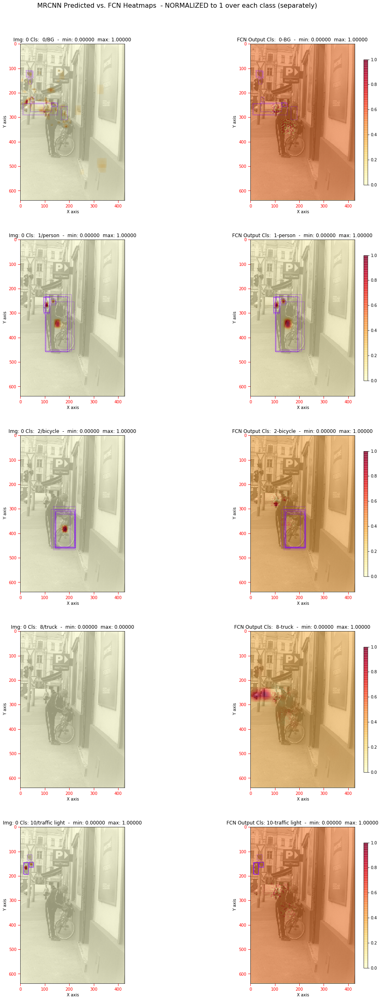

In [120]:
visualize.display_heatmaps_compare(mrcnn_input, mrcnn_output, heatmap = model_fcn_heatmap, image_id = 0, hm = 'pr', 
                     config = mrcnn_model.config, class_ids = gt_class_ids, class_names = coco_class_names, scaling = 'each')